## Refine Mesenchymal cell annotations for Williams 2021 Periodontitis dataset - relabelling uncertain cells based on majority voting

In [1]:
import scanpy as sc
import pandas as pd
import numpy as np
import sys
import os
from collections import Counter

import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import to_hex
import ast

In [2]:
sc.logging.print_header()

scanpy==1.8.0 anndata==0.8.0 umap==0.4.6 numpy==1.20.1 scipy==1.6.1 pandas==1.3.5 scikit-learn==0.24.1 statsmodels==0.13.5 python-igraph==0.8.3 louvain==0.7.0 leidenalg==0.8.3 pynndescent==0.5.2


In [3]:
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42

In [4]:
sc.set_figure_params(
    dpi=200,dpi_save=300,
    fontsize=12,
    frameon=False,
    transparent=True,
)

In [5]:
sns.set_style(style="white")
sns.set_context(context="paper")

#### Import

In [6]:
#import data
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Williams_data/Williams2021_periodontitis_fibroblasts_withrawcounts.20231108.h5ad')

In [7]:
adata

AnnData object with n_obs × n_vars = 4777 × 33694
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'project', 'percent.mt', 'S.Score', 'G2M.Score', 'paperLabels'
    var: 'name'
    uns: 'paperLabels_colors'
    obsm: 'X_pca', 'X_umap'
    layers: 'counts'

In [8]:
#import scanvi latent coordinates
adata_scanvi = pd.read_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/oral_mucosa_fibroblasts/oral_mucosa_fibroblast_Williams2021_periodontitis_fine_annot_predict_Mes_20231109.csv.gz',compression='gzip',index_col=0)

In [9]:
adata_scanvi

,LV1,LV2,LV3,LV4,LV5,LV6,LV7,LV8,LV9,LV10,LV11,LV12,LV13,LV14,LV15,LV16,LV17,LV18,LV19,LV20
PD134_AAAGATGTCTAGCACA-1,-0.011705,-0.065513,0.282249,0.007693,0.014861,0.515556,-0.028657,-0.485965,0.660496,0.959534,0.537593,1.923542,0.102465,0.095615,0.016616,0.003676,0.168270,-0.001998,-0.347126,0.029994
PD134_AAAGCAAAGACCACGA-1,0.026555,-0.028285,-0.678230,0.065496,-0.009941,-0.896403,-0.077241,-0.142470,1.152378,1.430416,0.449662,1.057728,-1.368906,0.100034,0.027486,-0.100089,-0.841864,-0.012531,-0.122853,1.201358
PD134_AAAGTAGGTCCGCTGA-1,0.037364,-0.027844,-0.739298,-0.031137,-0.006353,-0.516897,-0.410733,0.240509,-0.161926,-0.431675,-0.589035,-0.841650,0.148121,-0.013723,-0.138188,0.047942,0.390191,0.030870,-1.320248,0.126459
PD134_AAATGCCAGCTAGCCC-1,0.036883,-0.043849,-0.279374,0.047027,0.008935,-0.821515,-0.203306,-0.502470,0.509892,0.308394,-0.412172,0.803262,-0.667221,0.100965,-0.022606,0.018078,-0.389125,-0.011452,-0.926991,-0.155406
PD134_AAATGCCTCAGGATCT-1,0.004606,-0.033072,-0.208332,0.084466,0.019911,0.021961,0.417084,-0.522390,1.192838,0.829665,-0.185598,0.090584,-0.097764,0.084029,0.004216,-0.049829,-0.982657,-0.012584,-0.315727,0.629357
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
PD170_TTTCATGCACTTGAGT-1,0.039744,-0.010770,-0.693066,-0.045700,0.106216,1.200284,0.246545,0.625488,-0.272953,1.306563,-0.756140,0.437654,-0.462632,0.074069,0.001363,0.004302,-0.416889,0.049221,-0.950969,-0.076935
PD170_TTTCCTCTCTCGCGTT-1,-0.014667,-0.057863,-0.386748,0.013384,0.014513,0.427008,-0.426746,-0.195607,1.271436,0.389171,-0.549582,1.415324,0.251511,0.130159,-0.019520,0.063548,-0.523334,-0.049193,-0.833789,-0.455111
PD170_TTTGACTAGAACAGGA-1,-0.005264,-0.081201,0.329895,0.043618,0.075799,0.297142,0.387659,0.131111,1.245835,1.579763,0.398703,1.354842,-1.310570,0.099814,0.065958,-0.118640,-0.286683,-0.064059,-0.530565,1.114518
PD170_TTTGATCTCAGAGTGG-1,-0.015096,-0.054614,0.305531,0.087473,-0.017994,-0.332579,0.183530,-0.850714,1.068507,0.412298,0.087208,0.813953,0.437485,0.105705,0.008275,-0.017428,-0.916731,-0.036104,-0.481927,0.362199


In [10]:
adata.obsm['X_scANVI'] = adata_scanvi

In [11]:
#import metadata
adata_meta = pd.read_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/oral_mucosa_fibroblasts/oral_mucosa_fibroblast_Williams2021_periodontitis_fine_annot_predict_metadata_20231109.csv',index_col=0)

In [12]:
adata_meta

,orig.ident,nCount_RNA,nFeature_RNA,project,percent.mt,S.Score,G2M.Score,paperLabels,donorID_unified,_scvi_batch,...,_scvi_labels,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,log1p_n_counts,percent_mito,fine_predicted_labels,fine_predicted_labels_uncertainty,scanvi_pred
PD134_AAAGATGTCTAGCACA-1,PD134,3496.0,1387,PD,3.546911,-0.025040,-0.111120,P.Fib 1.1,PD134,141,...,14,336,5.820083,1141.0,7.040536,7.040536,3.546911,Oral_mucosa_fibroblast,0.179998,Oral_mucosa_fibroblast
PD134_AAAGCAAAGACCACGA-1,PD134,4702.0,1663,PD,0.638026,-0.051681,-0.014894,P.Fib 1.1,PD134,141,...,14,443,6.095825,1956.0,7.579168,7.579168,0.638026,Oral_mucosa_fibroblast,0.199994,Oral_mucosa_fibroblast
PD134_AAAGTAGGTCCGCTGA-1,PD134,997.0,638,PD,5.817452,-0.040260,-0.040834,P.Fib 1.3,PD134,141,...,14,146,4.990433,250.0,5.525453,5.525453,5.817452,Crypt_fibroblast_PI16,0.319986,Crypt_fibroblast_PI16
PD134_AAATGCCAGCTAGCCC-1,PD134,3409.0,1200,PD,7.920211,0.167046,0.027811,P.Fib 1.1,PD134,141,...,14,300,5.707110,898.0,6.801283,6.801283,7.920211,Oral_mucosa_fibroblast,0.639980,Oral_mucosa_fibroblast
PD134_AAATGCCTCAGGATCT-1,PD134,981.0,488,PD,8.970438,-0.017906,-0.045940,P.Fib 1.1,PD134,141,...,14,141,4.955827,314.0,5.752573,5.752573,8.970438,Oral_mucosa_fibroblast,0.460002,Oral_mucosa_fibroblast
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
PD170_TTTCATGCACTTGAGT-1,PD170,5534.0,2119,PD,3.794724,-0.091919,-0.064426,P.Fib 1.2,PD170,148,...,14,474,6.163315,1788.0,7.489412,7.489412,3.794724,Lamina_propria_fibroblast_ADAMDEC1,0.160012,Oesophagus_fibroblast
PD170_TTTCCTCTCTCGCGTT-1,PD170,8553.0,2575,PD,3.998597,-0.024039,-0.031477,P.Fib 1.1,PD170,148,...,14,567,6.342121,2791.0,7.934514,7.934514,3.998597,Oral_mucosa_fibroblast,0.219956,Oral_mucosa_fibroblast
PD170_TTTGACTAGAACAGGA-1,PD170,5285.0,2080,PD,6.490066,0.095829,-0.063430,P.Fib 1.1,PD170,148,...,14,471,6.156979,1709.0,7.444249,7.444249,6.490066,Oral_mucosa_fibroblast,0.079993,Oral_mucosa_fibroblast
PD170_TTTGATCTCAGAGTGG-1,PD170,6812.0,2199,PD,4.242513,-0.087409,-0.128161,P.Fib 1.1,PD170,148,...,14,505,6.226537,2501.0,7.824846,7.824846,4.242513,Oral_mucosa_fibroblast,0.099994,Oral_mucosa_fibroblast


In [13]:
adata.obs = adata_meta

#### Process

In [14]:
sc.pp.neighbors(adata, use_rep="X_scANVI")
sc.tl.umap(adata)

/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


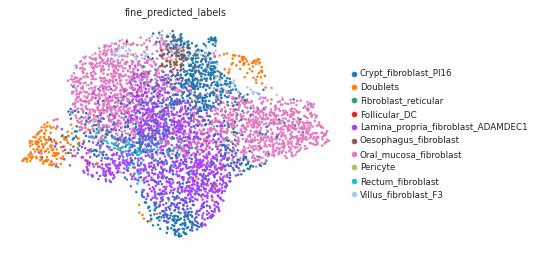

In [15]:
sc.pl.umap(adata, color=['fine_predicted_labels'])

In [16]:
adata.obs['donor_disease'] = 'periodontitis'

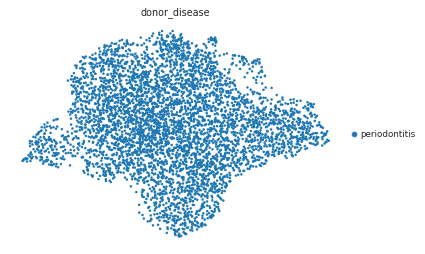

In [17]:
sc.pl.umap(adata, color=['donor_disease'])

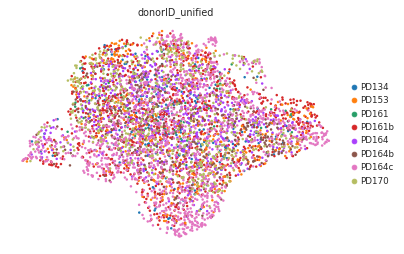

In [18]:
sc.pl.umap(adata, color=['donorID_unified'])

In [19]:
adata.obs['disease'] = 'periodontitis'

In [20]:
adata.obs.disease.value_counts()

periodontitis    4777
Name: disease, dtype: int64

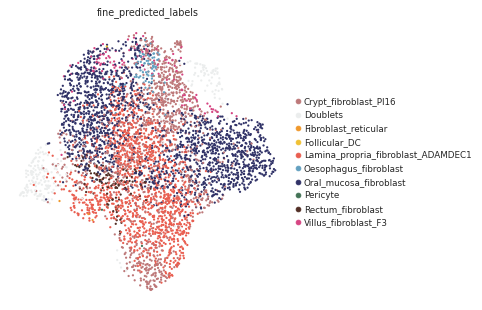

In [21]:
#plot UMAPs
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(adata,color='fine_predicted_labels',palette = ['#bd7879',#'Crypt_fibroblast_PI16', 
                                                          '#ebeded',#doublets
                                                          
           '#f0982c',#'Follicular_DC', 
                                                          '#f0c134',#'Stromal_fibroblast_reticular',
                                                          
           #'#AAC789',#'Immune_recruiting_pericyte',
           '#e95e50',#'Lamina_propria_fibroblast_ADAMDEC1', 
           #'#8F6592',#'Mesothelium', 
          # '#CCAE91',#'Myofibroblast',
           '#63A0C0',#'Oesophagus_fibroblast', 
           '#303267',#'Oral_mucosa_fibroblast', 
           '#437356',#'Pericyte',
           '#522e25',#'Rectum_fibroblast',
           
          # '#1E4147',#'Vascular_smooth_muscle',
           '#d64582'#'Villus_fibroblast_F3'
                                                         ]
           ,size=20)

In [22]:
adata.X.max()

8.634931

In [23]:
marker_genes_dict = {'General fibroblast markers':['VCAN', 'PDGFRA'],
                     'General smooth muscle/pericyte markers':['TAGLN', 'ACTA2','TPM2', 'MYH11'],
                     'Crypt_fibroblast_PI16':['PI16','RSPO3','SFRP1','ITM2A'],
                     'Follicular_DC':['FDCSP','SRGN','CR2','CLU','CSTA'],
                     'Immune_recruiting_pericyte':['GPC3','COL14A1','ID4','FHL2','CXCL12'],#'ECRG4',
                     'Lamina_propria_fibroblast_ADAMDEC1':['ADAMDEC1','CXCL14','ADAM28','CCL11','CCL8','CCL13','CFD'],
                     'Mesothelium':['UPK3B','MSLN','SLPI','KRT19'],
                     'Myofibroblast':['ACTG2','HHIP','SOSTDC1','NPNT'],
                     'Oesophagus_fibroblast':['APOD','PLPP1','MFAP4','IFITM1','RASD1'],
                     'Oral_mucosa_fibroblast':['CTHRC1','COL12A1','COL1A1','CTSK','COL5A2'],
                     'Pericyte':['CD36','COX4I2','HIGD1B','RGS5','NDUFA4L2'],
                     'Rectum_fibroblast':['KCNN3','THBS4','FNDC1','PPFIBP1'],
                     'Stromal_fibroblast_retictular':['CCL21','CCL19','TNFSF13B','TDO2'],
                     'Vascular_smooth_muscle':['RERGL','MUSTN1','LBH','NET1',],#'MAP3K20'
                     'Villus_fibroblast_F3':['F3','PLAT','HSD17B2','SOX6']}

In [24]:
adata

AnnData object with n_obs × n_vars = 4777 × 33694
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'project', 'percent.mt', 'S.Score', 'G2M.Score', 'paperLabels', 'donorID_unified', '_scvi_batch', 'fine_annot', '_scvi_labels', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'log1p_n_counts', 'percent_mito', 'fine_predicted_labels', 'fine_predicted_labels_uncertainty', 'scanvi_pred', 'donor_disease', 'disease'
    var: 'name'
    uns: 'paperLabels_colors', 'neighbors', 'umap', 'fine_predicted_labels_colors', 'donor_disease_colors', 'donorID_unified_colors'
    obsm: 'X_pca', 'X_umap', 'X_scANVI'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


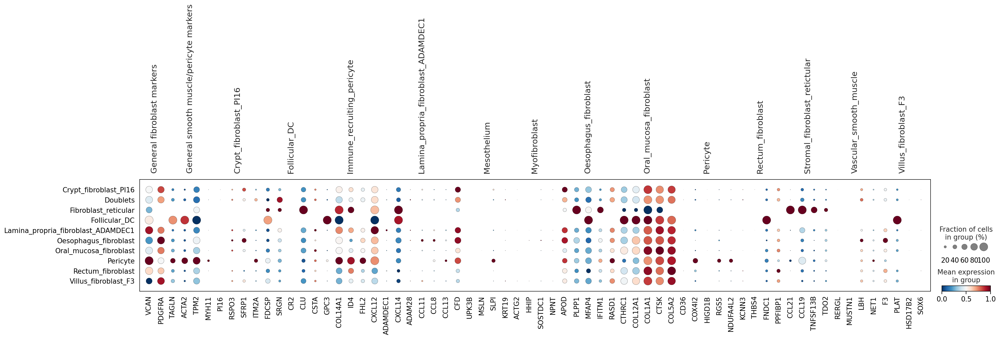

In [25]:
#plot marker genes
sc.set_figure_params(dpi_save = 300)
sc.pl.dotplot(adata,var_names=marker_genes_dict,groupby='fine_predicted_labels',color_map='RdBu_r', standard_scale='var')

#### Classify uncertain cells

In [26]:
uncert = adata.obs[['fine_predicted_labels','fine_predicted_labels_uncertainty']] 

In [27]:
#calculate 90th percentile to use as cut off for uncertain cells
p = np.percentile(adata.obs['fine_predicted_labels_uncertainty'], 90) # return 90th percentile
print(p)

0.5599708297936781


(array([394., 186., 277., 214., 130., 256., 210., 118., 200., 197., 137.,
        201., 210., 129., 241., 229., 145., 226., 253., 165., 209., 172.,
         86., 108.,  52.,  11.,  18.,   2.,   0.,   1.]),
 array([0.        , 0.02666654, 0.05333308, 0.07999961, 0.10666615,
        0.13333269, 0.15999923, 0.18666577, 0.21333231, 0.23999884,
        0.26666538, 0.29333192, 0.31999846, 0.346665  , 0.37333153,
        0.39999807, 0.42666461, 0.45333115, 0.47999769, 0.50666423,
        0.53333076, 0.5599973 , 0.58666384, 0.61333038, 0.63999692,
        0.66666345, 0.69332999, 0.71999653, 0.74666307, 0.77332961,
        0.79999614]),
 <BarContainer object of 30 artists>)

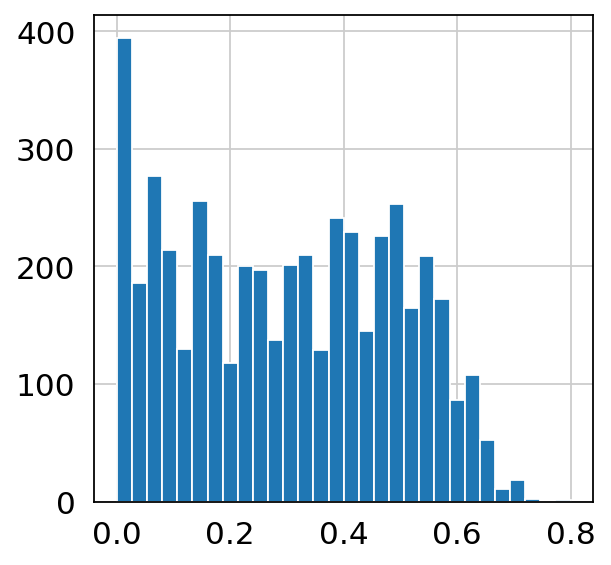

In [28]:
#plot uncertainty distribution
plt.hist(adata.obs['fine_predicted_labels_uncertainty'], bins=30)

In [29]:
uncert['fine_predicted_labels'] = uncert['fine_predicted_labels'].cat.add_categories('Unknown')

<ipython-input-29-905f2ed234d6>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  uncert['fine_predicted_labels'] = uncert['fine_predicted_labels'].cat.add_categories('Unknown')


In [30]:
adata.obs['fine_predicted_labels'].unique()

['Oral_mucosa_fibroblast', 'Crypt_fibroblast_PI16', 'Lamina_propria_fibroblast_ADAMDEC1', 'Doublets', 'Villus_fibroblast_F3', 'Rectum_fibroblast', 'Oesophagus_fibroblast', 'Pericyte', 'Follicular_DC', 'Fibroblast_reticular']
Categories (10, object): ['Crypt_fibroblast_PI16', 'Doublets', 'Fibroblast_reticular', 'Follicular_DC', ..., 'Oral_mucosa_fibroblast', 'Pericyte', 'Rectum_fibroblast', 'Villus_fibroblast_F3']

In [31]:
#mark cells are unknown based on cut off of 90th percentile
uncert.loc[uncert["fine_predicted_labels_uncertainty"] > p, "fine_predicted_labels"] = "Unknown"

/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/pandas/core/indexing.py:1817: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_column(loc, value, pi)


In [32]:
adata.obs['fine_predicted_labels_uncertflagged'] = adata.obs['fine_predicted_labels']

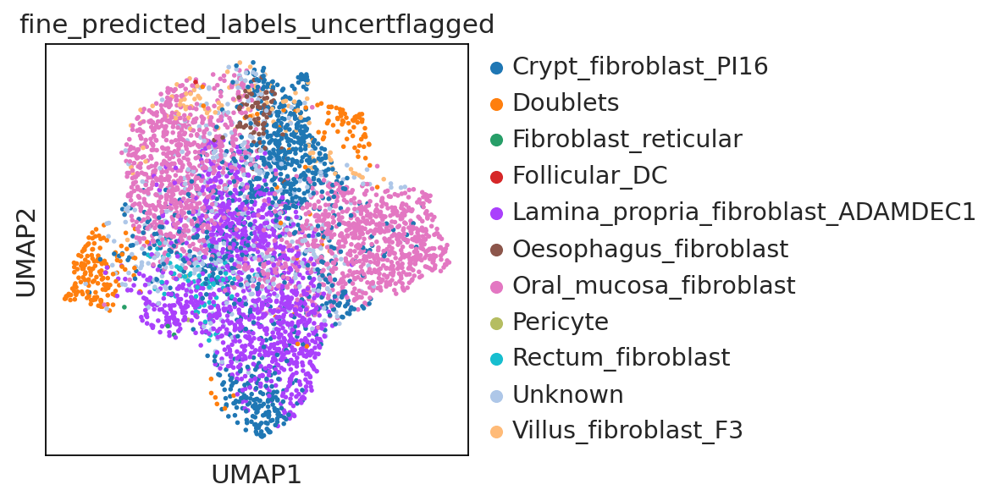

In [33]:
ON = {O:N for O,N in zip(uncert.index,uncert["fine_predicted_labels"])}
adata.obs["fine_predicted_labels_uncertflagged"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["fine_predicted_labels_uncertflagged"])]
sc.pl.umap(adata,color='fine_predicted_labels_uncertflagged')

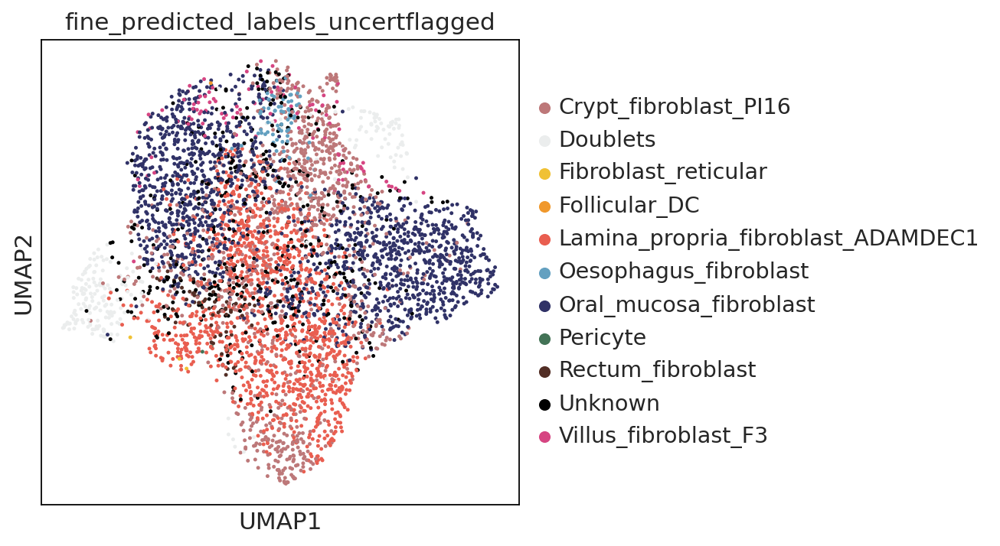

In [34]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(adata,color='fine_predicted_labels_uncertflagged',palette = ['#bd7879',#'Crypt_fibroblast_PI16', 
                                                          '#ebeded',#doublets
           '#f0c134',#'Stromal_fibroblast_reticular',
                                                                        '#f0982c',#'Follicular_DC', 
                                                          
                                                          
           #'#AAC789',#'Immune_recruiting_pericyte',
           '#e95e50',#'Lamina_propria_fibroblast_ADAMDEC1', 
           #'#8F6592',#'Mesothelium', 
          # '#CCAE91',#'Myofibroblast',
           '#63A0C0',#'Oesophagus_fibroblast', 
           '#303267',#'Oral_mucosa_fibroblast', 
           '#437356',#'Pericyte',
           '#522e25',#'Rectum_fibroblast',
           '#000000',#unknown
          # '#1E4147',#'Vascular_smooth_muscle',
           '#d64582'#'Villus_fibroblast_F3'

                                                                       ],size=20)

/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


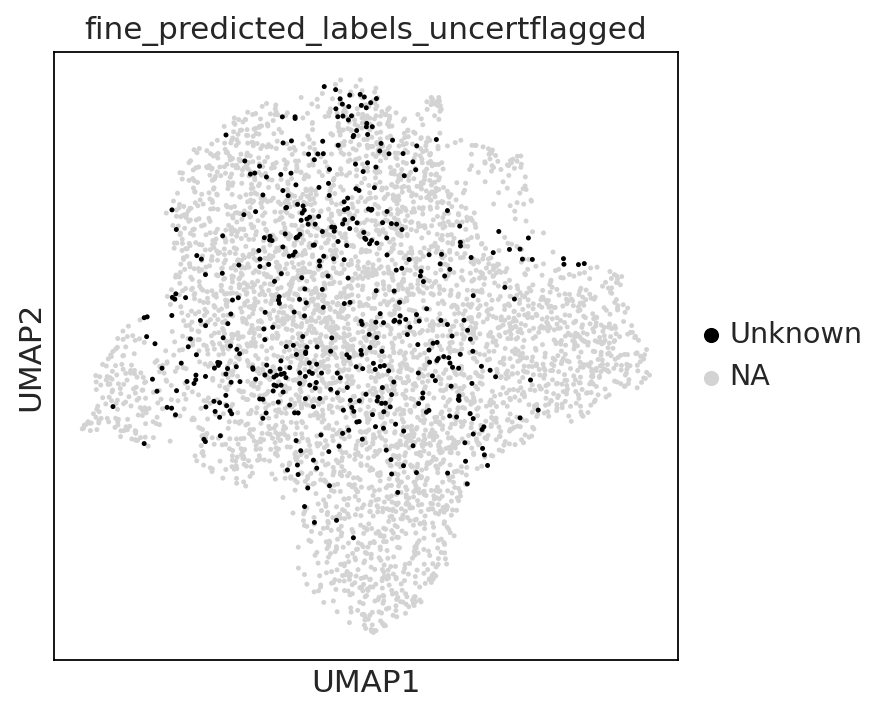

In [35]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(adata,color='fine_predicted_labels_uncertflagged',groups='Unknown',size=20)

In [36]:
adata.obs.fine_predicted_labels_uncertflagged.value_counts()

Oral_mucosa_fibroblast                1617
Lamina_propria_fibroblast_ADAMDEC1    1232
Crypt_fibroblast_PI16                  991
Unknown                                444
Doublets                               240
Villus_fibroblast_F3                   100
Rectum_fibroblast                       74
Oesophagus_fibroblast                   70
Pericyte                                 5
Fibroblast_reticular                     3
Follicular_DC                            1
Name: fine_predicted_labels_uncertflagged, dtype: int64

#### Finalise cell annotations

In [37]:
#reassign labels for unknown cells by leiden clustering and majority voting
sc.tl.leiden(adata,resolution=1,key_added='leiden1')

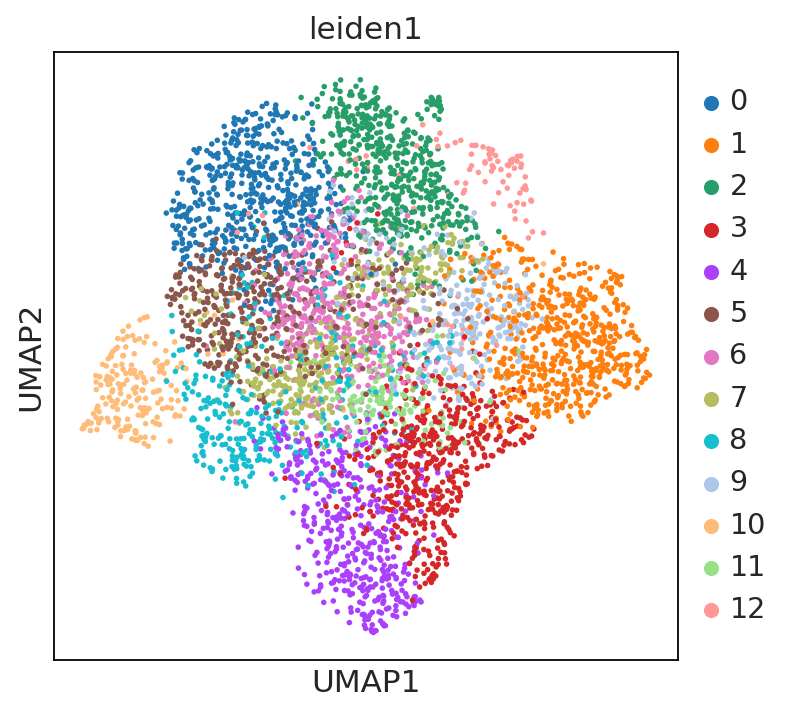

In [38]:
sc.pl.umap(adata,color='leiden1')

In [39]:
#quick look at leiden resolution 0.5
sc.tl.leiden(adata,resolution=0.5,key_added='leiden0.5')

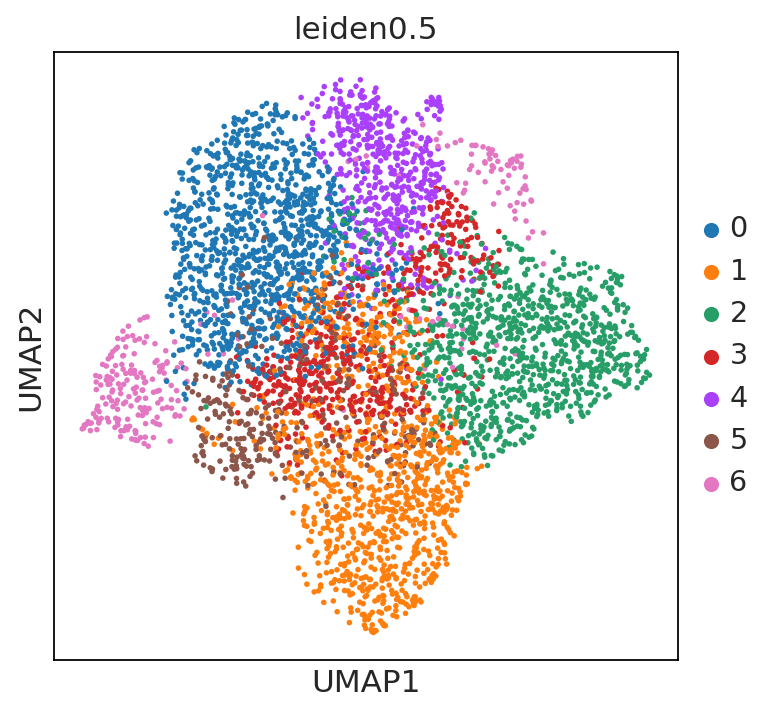

In [40]:
sc.pl.umap(adata,color='leiden0.5')

In [41]:
pd.crosstab(adata.obs.fine_predicted_labels_uncertflagged,adata.obs.leiden1)

leiden1,0,1,2,3,4,5,6,7,8,9,10,11,12
fine_predicted_labels_uncertflagged,,,,,,,,,,,,,
Crypt_fibroblast_PI16,28,36,306,72,192,43,44,196,22,15,12,21,4
Doublets,3,1,2,3,7,3,0,0,7,1,139,0,74
Fibroblast_reticular,0,0,0,0,0,0,0,0,2,0,1,0,0
Follicular_DC,1,0,0,0,0,0,0,0,0,0,0,0,0
Lamina_propria_fibroblast_ADAMDEC1,47,1,5,334,208,41,260,50,228,28,9,21,0
Oesophagus_fibroblast,2,0,67,0,0,0,1,0,0,0,0,0,0
Oral_mucosa_fibroblast,391,487,39,54,0,264,55,22,34,187,4,70,10
Pericyte,0,0,0,0,2,1,0,1,1,0,0,0,0
Rectum_fibroblast,0,0,0,0,13,12,0,40,4,0,0,5,0


In [42]:
pd.crosstab(adata.obs.fine_predicted_labels_uncertflagged,adata.obs['leiden0.5'])

leiden0.5,0,1,2,3,4,5,6
fine_predicted_labels_uncertflagged,,,,,,,
Crypt_fibroblast_PI16,87,223,90,253,308,14,16
Doublets,13,11,1,1,2,0,212
Fibroblast_reticular,0,0,0,0,0,2,1
Follicular_DC,1,0,0,0,0,0,0
Lamina_propria_fibroblast_ADAMDEC1,157,678,50,61,25,250,11
Oesophagus_fibroblast,2,0,0,0,68,0,0
Oral_mucosa_fibroblast,696,26,718,90,44,30,13
Pericyte,0,2,0,2,0,1,0
Rectum_fibroblast,10,10,0,50,0,4,0


In [43]:
#Use Leiden resolution 1
unknown = adata.obs[['leiden1','fine_predicted_labels_uncertflagged']]

In [44]:
unknown = unknown[unknown['fine_predicted_labels_uncertflagged'].isin(['Unknown'])]

In [45]:
unknown

,leiden1,fine_predicted_labels_uncertflagged
PD134_AAATGCCAGCTAGCCC-1,9,Unknown
PD134_AAGGCAGGTAACGACG-1,9,Unknown
PD134_ACACCAACAACAACCT-1,0,Unknown
PD134_ACACCCTTCGCTTGTC-1,3,Unknown
PD134_ACATACGGTCGTGGCT-1,3,Unknown
...,...,...
PD170_TGGGTTATCTAGGCCG-1,1,Unknown
PD170_TGTCAGACAGTGCCTG-1,9,Unknown
PD170_TTACTGTTCATCAGTG-1,5,Unknown
PD170_TTCATGTCAAGCACCC-1,10,Unknown


/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


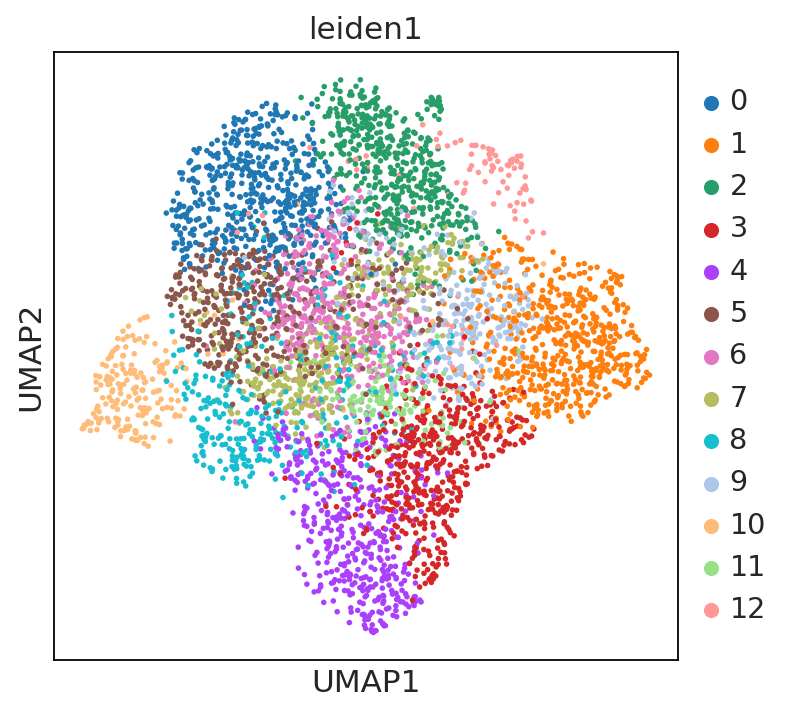

In [46]:
sc.pl.umap(adata,color='leiden1')

/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


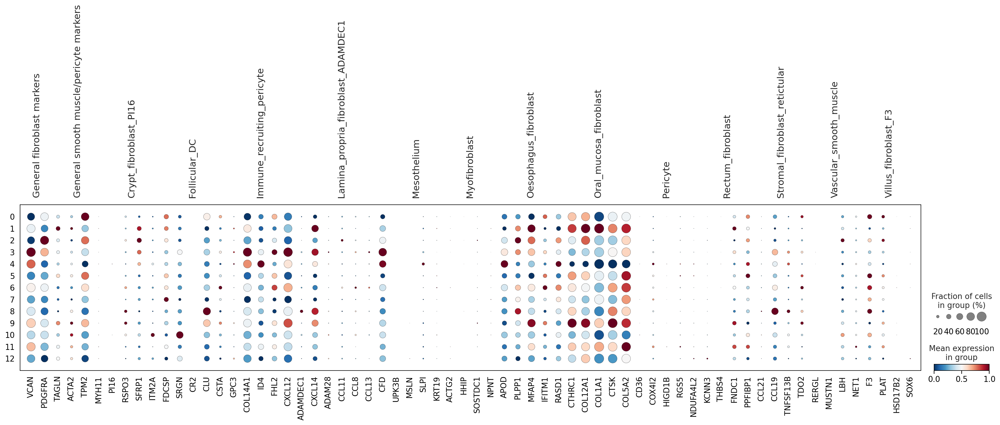

In [47]:
sc.pl.dotplot(adata,var_names=marker_genes_dict,groupby='leiden1',color_map='RdBu_r', standard_scale='var')

In [48]:
pd.crosstab(adata.obs.fine_predicted_labels_uncertflagged,adata.obs.leiden1)

leiden1,0,1,2,3,4,5,6,7,8,9,10,11,12
fine_predicted_labels_uncertflagged,,,,,,,,,,,,,
Crypt_fibroblast_PI16,28,36,306,72,192,43,44,196,22,15,12,21,4
Doublets,3,1,2,3,7,3,0,0,7,1,139,0,74
Fibroblast_reticular,0,0,0,0,0,0,0,0,2,0,1,0,0
Follicular_DC,1,0,0,0,0,0,0,0,0,0,0,0,0
Lamina_propria_fibroblast_ADAMDEC1,47,1,5,334,208,41,260,50,228,28,9,21,0
Oesophagus_fibroblast,2,0,67,0,0,0,1,0,0,0,0,0,0
Oral_mucosa_fibroblast,391,487,39,54,0,264,55,22,34,187,4,70,10
Pericyte,0,0,0,0,2,1,0,1,1,0,0,0,0
Rectum_fibroblast,0,0,0,0,13,12,0,40,4,0,0,5,0


In [49]:
unknown_adata = adata[adata.obs['fine_predicted_labels_uncertflagged'].isin(['Unknown'])].copy()

/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


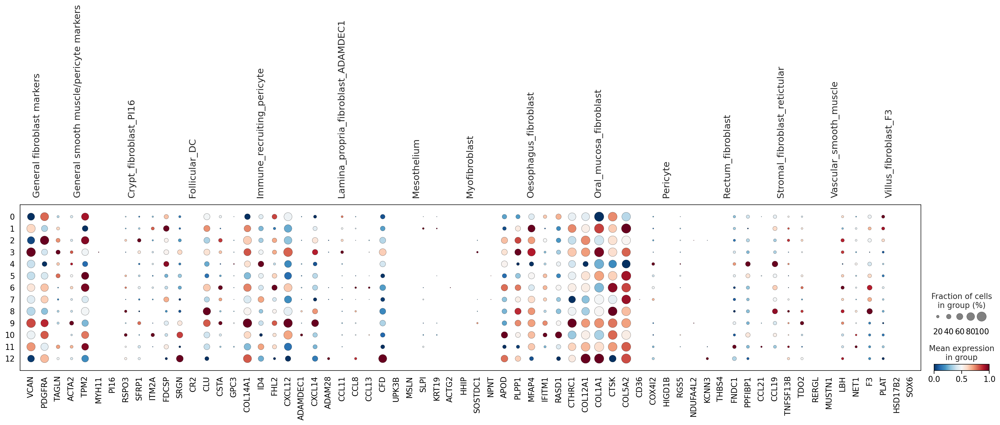

In [50]:
sc.pl.dotplot(unknown_adata,var_names=marker_genes_dict,groupby='leiden1',color_map='RdBu_r', standard_scale='var')

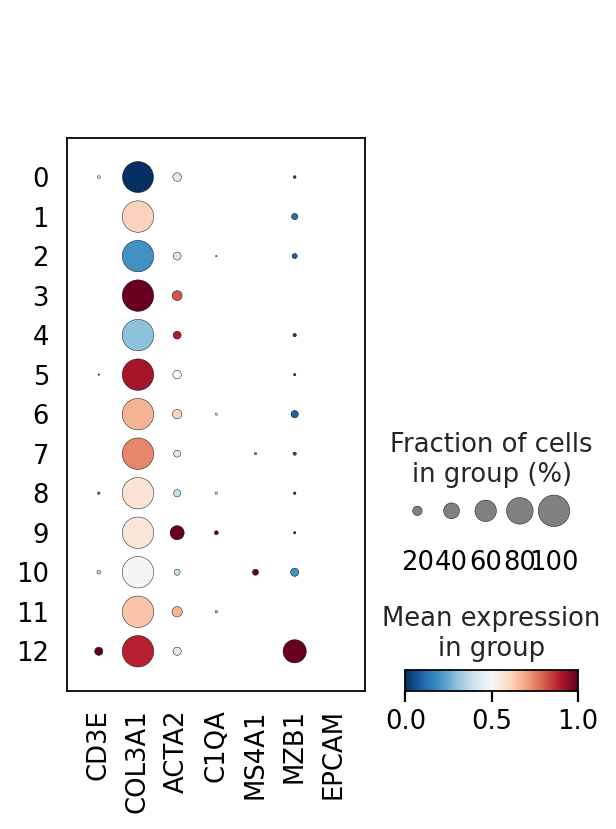

In [51]:
#plot some doublet markers
sc.pl.dotplot(unknown_adata,var_names=['CD3E','COL3A1','ACTA2','C1QA','MS4A1','MZB1','EPCAM'],groupby='leiden1',color_map='RdBu_r', standard_scale='var')

/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


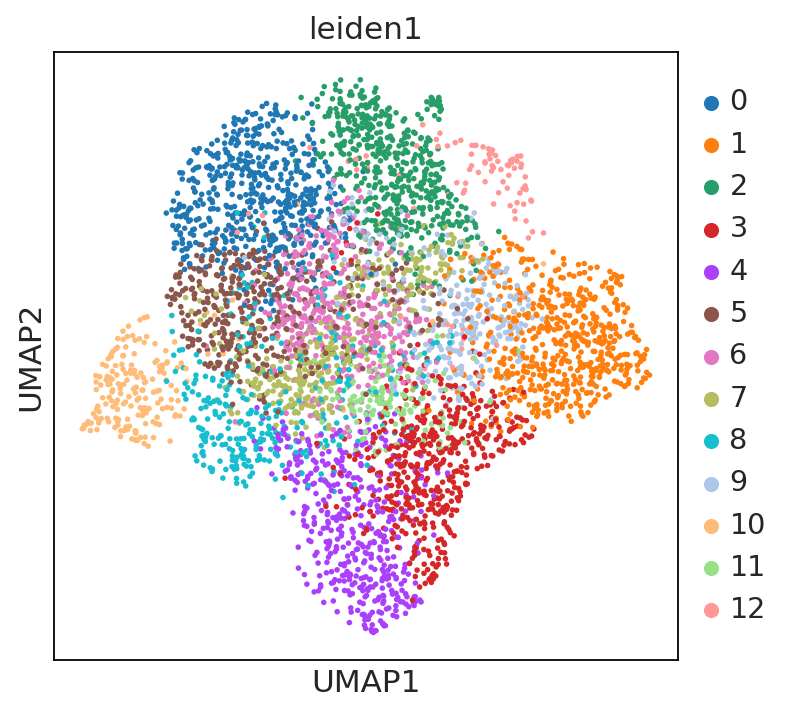

In [52]:
sc.pl.umap(adata,color='leiden1')

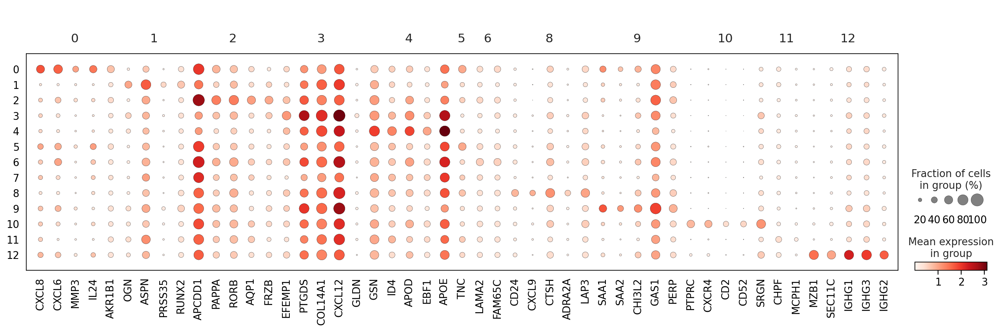

In [53]:
import sys
sys.path.append("/home/jovyan/ao15/Megagut/")
from re5_combine import *
adata.raw = adata.copy()
mkst = calc_marker_stats(adata, groupby="leiden1")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(adata, groupby='leiden1', mks=mks)

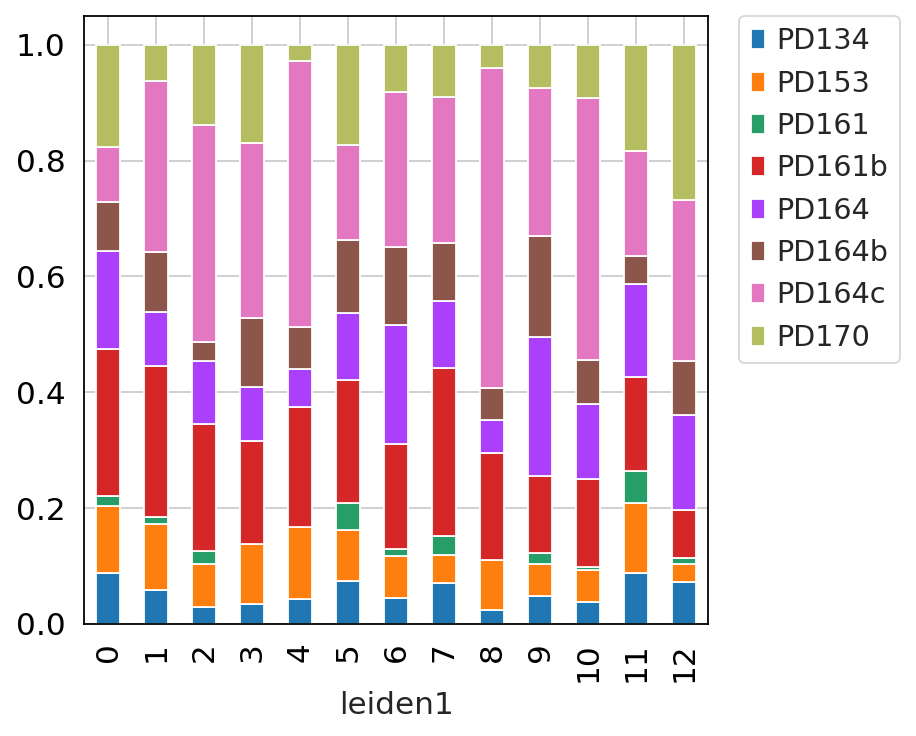

In [54]:
tmp = pd.crosstab(adata.obs['leiden1'], adata.obs['donorID_unified'],normalize='index'
                                                                         )
tmp.plot.bar(stacked=True).legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)

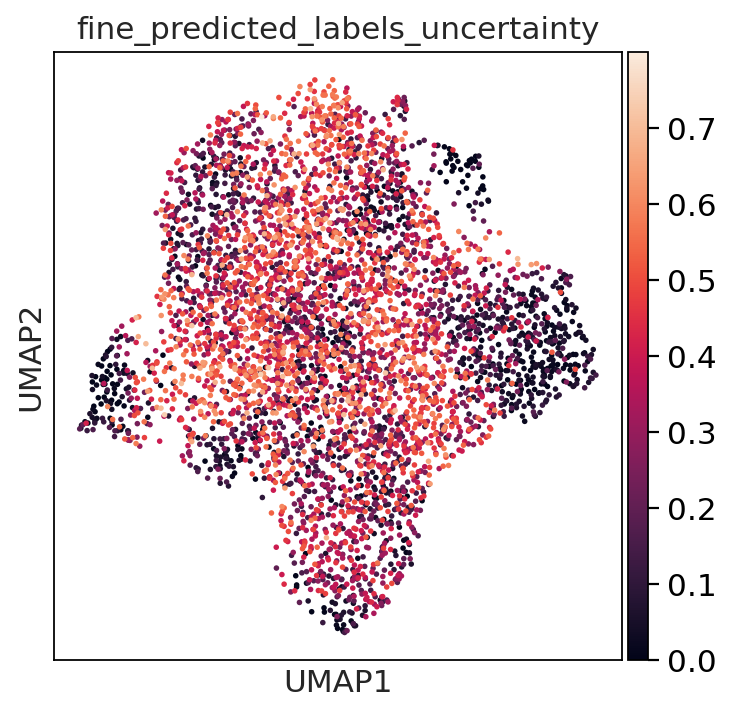

In [55]:
sc.pl.umap(adata,color='fine_predicted_labels_uncertainty')

In [56]:
pd.crosstab(adata.obs.fine_predicted_labels_uncertflagged,adata.obs.leiden1)

leiden1,0,1,2,3,4,5,6,7,8,9,10,11,12
fine_predicted_labels_uncertflagged,,,,,,,,,,,,,
Crypt_fibroblast_PI16,28,36,306,72,192,43,44,196,22,15,12,21,4
Doublets,3,1,2,3,7,3,0,0,7,1,139,0,74
Fibroblast_reticular,0,0,0,0,0,0,0,0,2,0,1,0,0
Follicular_DC,1,0,0,0,0,0,0,0,0,0,0,0,0
Lamina_propria_fibroblast_ADAMDEC1,47,1,5,334,208,41,260,50,228,28,9,21,0
Oesophagus_fibroblast,2,0,67,0,0,0,1,0,0,0,0,0,0
Oral_mucosa_fibroblast,391,487,39,54,0,264,55,22,34,187,4,70,10
Pericyte,0,0,0,0,2,1,0,1,1,0,0,0,0
Rectum_fibroblast,0,0,0,0,13,12,0,40,4,0,0,5,0


In [57]:
unknown['fine_predicted_labels_resolved'] = (unknown['leiden1']
        .map(lambda x:{'0':'Oral_mucosa_fibroblast',
                       '1':'Oral_mucosa_fibroblast',
                       '2':'Crypt_fibroblast_PI16',
                       '3':'Oral_mucosa_fibroblast', 
                       '4':'Lamina_propria_fibroblast_ADAMDEC1',
                       '5':'Oral_mucosa_fibroblast', 
                       '6':'Lamina_propria_fibroblast_ADAMDEC1',
                       '7':'Crypt_fibroblast_PI16',
                       '8':'Lamina_propria_fibroblast_ADAMDEC1', 
                       '9':'Oral_mucosa_fibroblast',
                       '10':'Doublets',
                       '11':'Oral_mucosa_fibroblast', 
                       '12':'Doublets',
                         }.get(x,x)).astype('category'))

In [58]:
unknown

,leiden1,fine_predicted_labels_uncertflagged,fine_predicted_labels_resolved
PD134_AAATGCCAGCTAGCCC-1,9,Unknown,Oral_mucosa_fibroblast
PD134_AAGGCAGGTAACGACG-1,9,Unknown,Oral_mucosa_fibroblast
PD134_ACACCAACAACAACCT-1,0,Unknown,Oral_mucosa_fibroblast
PD134_ACACCCTTCGCTTGTC-1,3,Unknown,Oral_mucosa_fibroblast
PD134_ACATACGGTCGTGGCT-1,3,Unknown,Oral_mucosa_fibroblast
...,...,...,...
PD170_TGGGTTATCTAGGCCG-1,1,Unknown,Oral_mucosa_fibroblast
PD170_TGTCAGACAGTGCCTG-1,9,Unknown,Oral_mucosa_fibroblast
PD170_TTACTGTTCATCAGTG-1,5,Unknown,Oral_mucosa_fibroblast
PD170_TTCATGTCAAGCACCC-1,10,Unknown,Doublets


In [59]:
adata

AnnData object with n_obs × n_vars = 4777 × 33694
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'project', 'percent.mt', 'S.Score', 'G2M.Score', 'paperLabels', 'donorID_unified', '_scvi_batch', 'fine_annot', '_scvi_labels', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'log1p_n_counts', 'percent_mito', 'fine_predicted_labels', 'fine_predicted_labels_uncertainty', 'scanvi_pred', 'donor_disease', 'disease', 'fine_predicted_labels_uncertflagged', 'leiden1', 'leiden0.5'
    var: 'name'
    uns: 'paperLabels_colors', 'neighbors', 'umap', 'fine_predicted_labels_colors', 'donor_disease_colors', 'donorID_unified_colors', 'fine_predicted_labels_uncertflagged_colors', 'leiden', 'leiden1_colors', 'leiden0.5_colors'
    obsm: 'X_pca', 'X_umap', 'X_scANVI'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

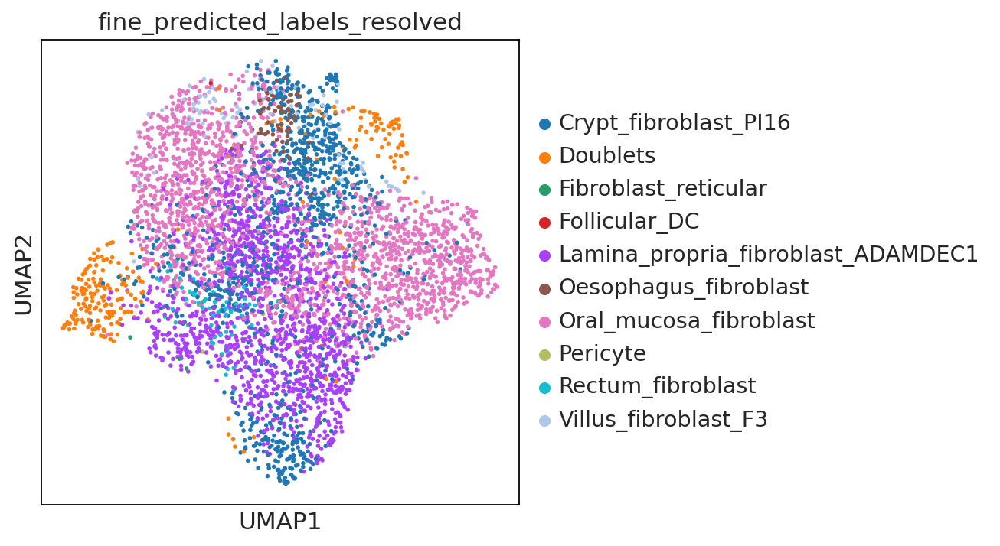

In [60]:
ON = {O:N for O,N in zip(unknown.index,unknown["fine_predicted_labels_resolved"])}
adata.obs["fine_predicted_labels_resolved"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["fine_predicted_labels_uncertflagged"])]
sc.pl.umap(adata,color='fine_predicted_labels_resolved')

In [61]:
no_doublets = adata[~adata.obs.fine_predicted_labels_resolved.isin(['Doublets'])].copy()

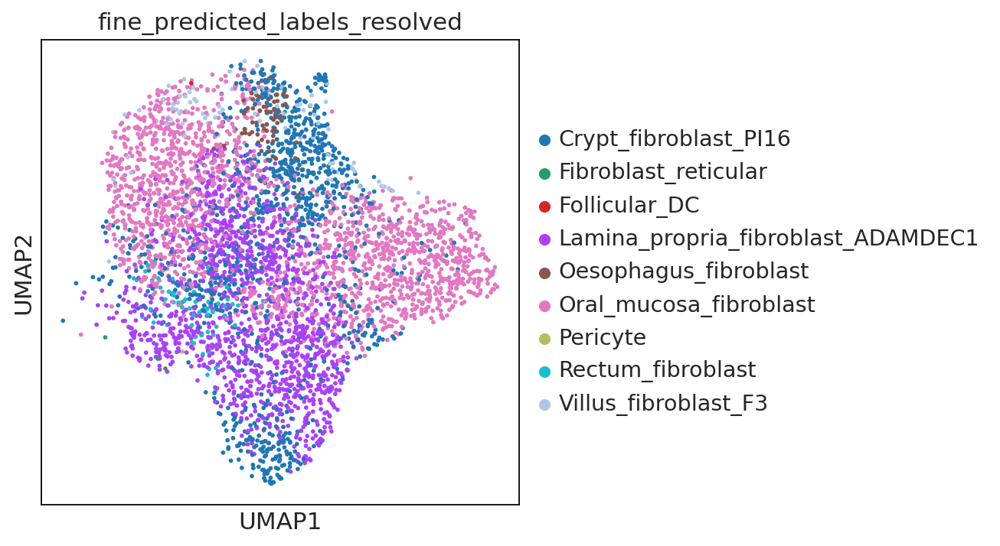

In [62]:
sc.pl.umap(no_doublets,color='fine_predicted_labels_resolved')

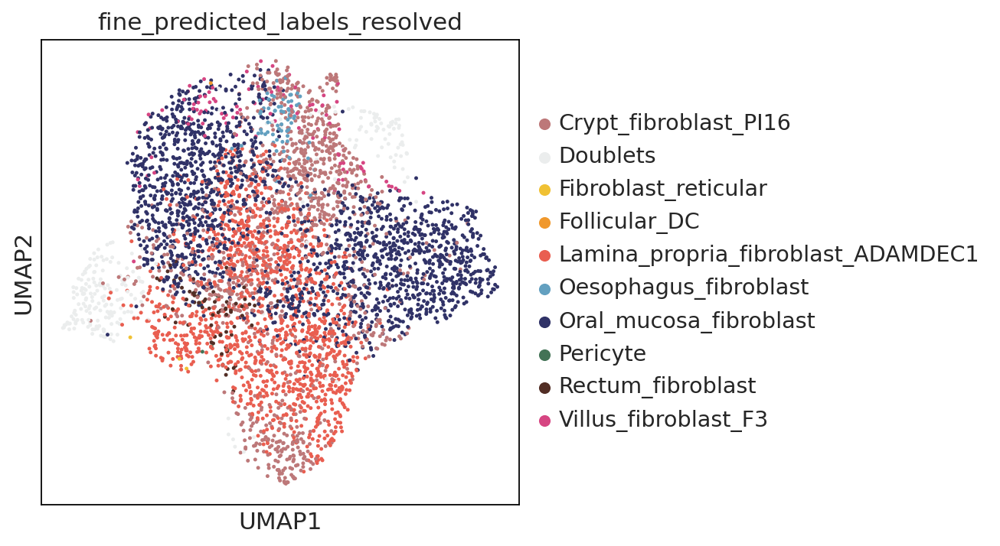

In [63]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(adata,color='fine_predicted_labels_resolved',palette = ['#bd7879',#'Crypt_fibroblast_PI16', 
                                                          '#ebeded',#doublets
           '#f0c134',#'Stromal_fibroblast_reticular',
                                                                        '#f0982c',#'Follicular_DC', 
                                                          
          # '#AAC789',#'Immune_recruiting_pericyte',
           '#e95e50',#'Lamina_propria_fibroblast_ADAMDEC1', 
          # '#8F6592',#'Mesothelium', 
           #'#CCAE91',#'Myofibroblast',
           '#63A0C0',#'Oesophagus_fibroblast', 
           '#303267',#'Oral_mucosa_fibroblast', 
           '#437356',#'Pericyte',
           '#522e25',#'Rectum_fibroblast',
           #'#000000',#unknown
          # '#1E4147',#'Vascular_smooth_muscle',
           '#d64582'#'Villus_fibroblast_F3'

    
                                              ],size=20)

In [64]:
annot = adata.obs[['fine_predicted_labels_uncertflagged','fine_predicted_labels_resolved']]

In [65]:
annot

,fine_predicted_labels_uncertflagged,fine_predicted_labels_resolved
PD134_AAAGATGTCTAGCACA-1,Oral_mucosa_fibroblast,Oral_mucosa_fibroblast
PD134_AAAGCAAAGACCACGA-1,Oral_mucosa_fibroblast,Oral_mucosa_fibroblast
PD134_AAAGTAGGTCCGCTGA-1,Crypt_fibroblast_PI16,Crypt_fibroblast_PI16
PD134_AAATGCCAGCTAGCCC-1,Unknown,Oral_mucosa_fibroblast
PD134_AAATGCCTCAGGATCT-1,Oral_mucosa_fibroblast,Oral_mucosa_fibroblast
...,...,...
PD170_TTTCATGCACTTGAGT-1,Lamina_propria_fibroblast_ADAMDEC1,Lamina_propria_fibroblast_ADAMDEC1
PD170_TTTCCTCTCTCGCGTT-1,Oral_mucosa_fibroblast,Oral_mucosa_fibroblast
PD170_TTTGACTAGAACAGGA-1,Oral_mucosa_fibroblast,Oral_mucosa_fibroblast
PD170_TTTGATCTCAGAGTGG-1,Oral_mucosa_fibroblast,Oral_mucosa_fibroblast


In [66]:
#export final annotations
annot.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/oral_mucosa_fibroblasts/Williams_periodontitis_annot_scanvi_transfer.csv')

### Analyse periodontitis data

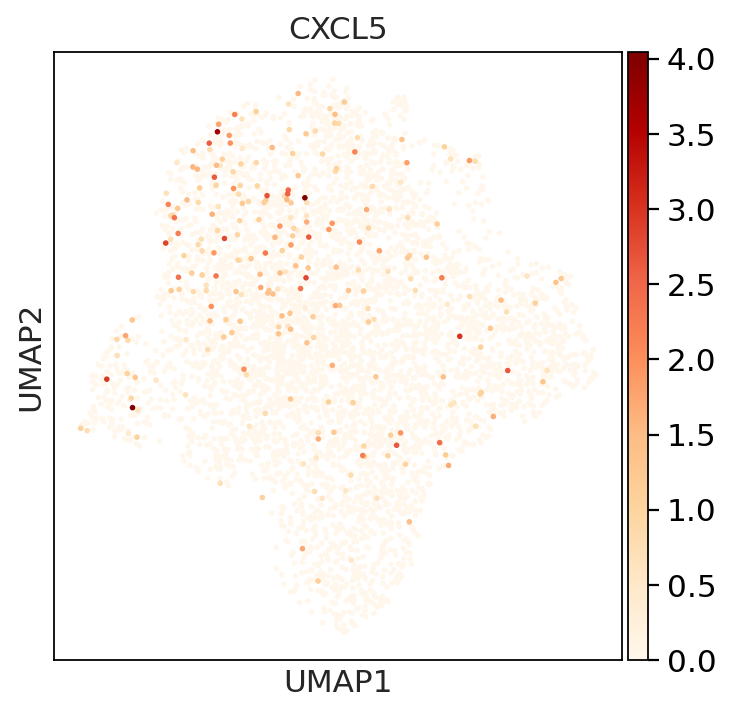

In [67]:
sc.pl.umap(adata,color=['CXCL5'],cmap='OrRd')

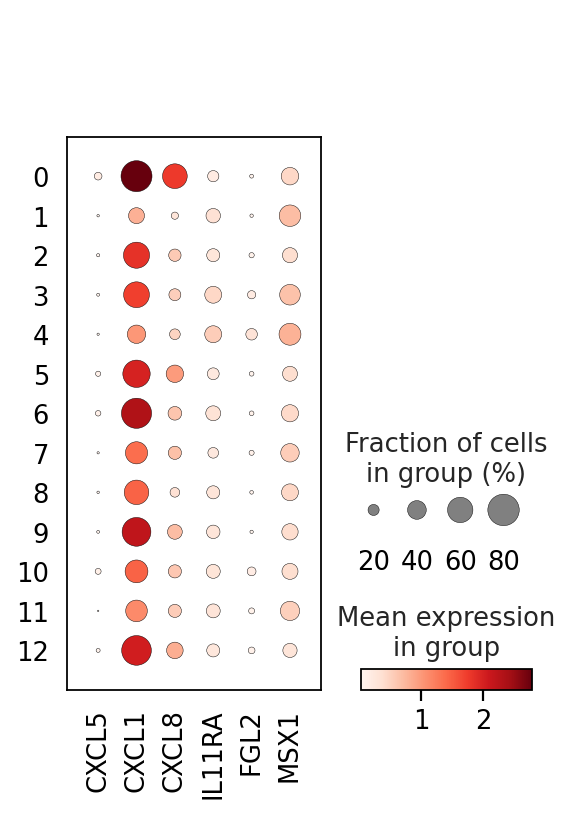

In [68]:
sc.pl.dotplot(adata,var_names=['CXCL5','CXCL1','CXCL8','IL11RA','FGL2','MSX1'],groupby='leiden1')

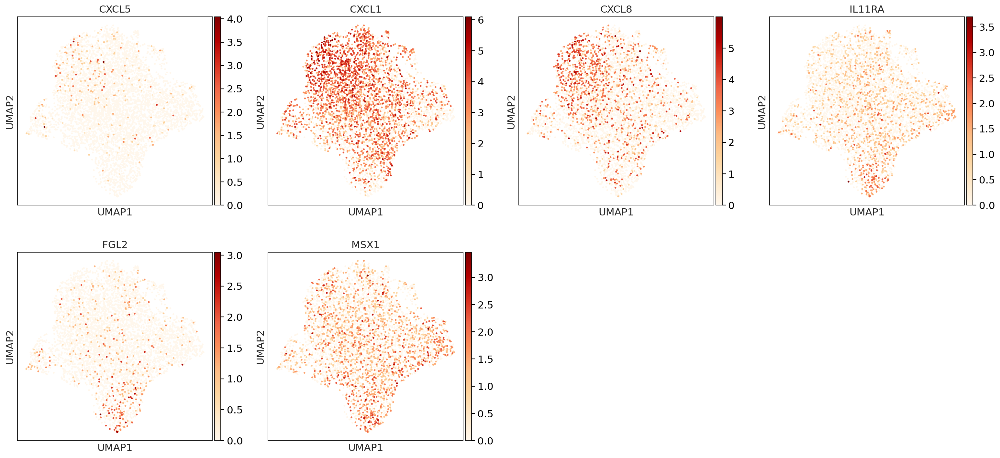

In [69]:
sc.pl.umap(adata,color=['CXCL5','CXCL1','CXCL8','IL11RA','FGL2','MSX1'],cmap='OrRd')

#### Import fibroblasts from the atlas

In [70]:
fibro = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/pooled_compartments/Mes_AP.pooled_healthy_disease.remapped.allgenes.fine_annot.no_doublets.20230418.h5ad')

In [71]:
fibro

AnnData object with n_obs × n_vars = 77050 × 36601
    var: 'gene_ids', 'feature_type', 'mito', 'ribo', 'hb', 'cc', 'ig', 'tcr', 'n_counts-0', 'n_counts_raw-0', 'n_counts_spliced-0', 'n_counts_unspliced-0', 'n_cells-0', 'n_cells_raw-0', 'n_cells_spliced-0', 'n_cells_unspliced-0', 'n_counts-1', 'n_counts_raw-1', 'n_counts_spliced-1', 'n_counts_unspliced-1', 'n_cells-1', 'n_cells_raw-1', 'n_cells_spliced-1', 'n_cells_unspliced-1'
    uns: 'age_unified_colors', 'control_vs_disease_colors', 'disease_colors', 'level_1_annot_colors', 'level_3_annot_colors', 'neighbors', 'organ_groups_colors', 'organ_unified_colors', 'study_colors', 'umap'
    obsm: 'X_scANVI', 'X_umap'
    obsp: 'connectivities', 'distances'

In [72]:
fibro.obs = pd.read_csv('/nfs/team205/ao15/Megagut/Annotations_v3/metadata/pooled_compartments/Mes_AP.pooled_healthy_disease.remapped.allgenes.fine_annot.no_doublets.20230418.csv',index_col=0)

In [73]:
fibro

AnnData object with n_obs × n_vars = 77050 × 36601
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spl

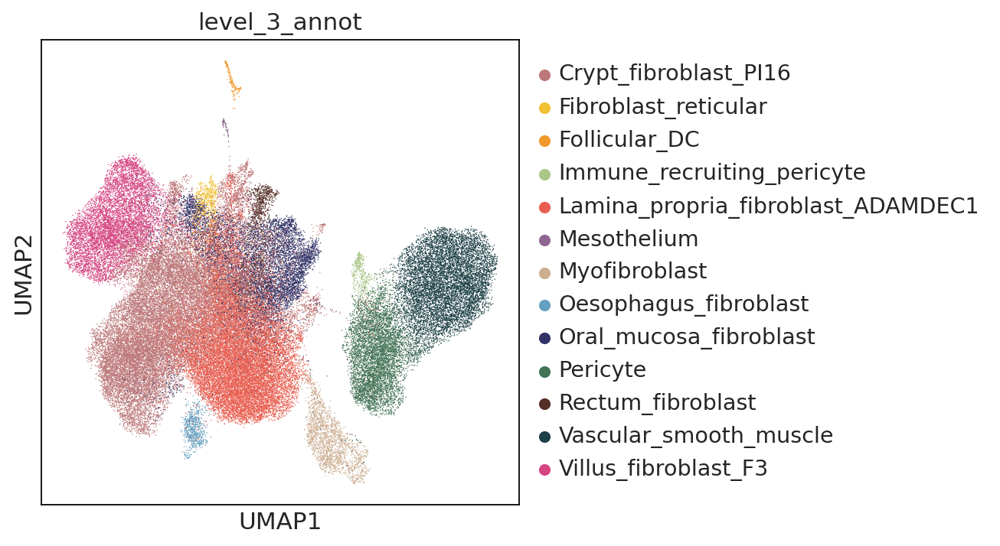

In [74]:
sc.pl.umap(fibro,color='level_3_annot')

#### Prepare for merging

In [75]:
adata

AnnData object with n_obs × n_vars = 4777 × 33694
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'project', 'percent.mt', 'S.Score', 'G2M.Score', 'paperLabels', 'donorID_unified', '_scvi_batch', 'fine_annot', '_scvi_labels', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'log1p_n_counts', 'percent_mito', 'fine_predicted_labels', 'fine_predicted_labels_uncertainty', 'scanvi_pred', 'donor_disease', 'disease', 'fine_predicted_labels_uncertflagged', 'leiden1', 'leiden0.5', 'fine_predicted_labels_resolved'
    var: 'name'
    uns: 'paperLabels_colors', 'neighbors', 'umap', 'fine_predicted_labels_colors', 'donor_disease_colors', 'donorID_unified_colors', 'fine_predicted_labels_uncertflagged_colors', 'leiden', 'leiden1_colors', 'leiden0.5_colors', 'fine_predicted_labels_resolved_colors'
    obsm: 'X_pca', 'X_umap', 'X_scANVI'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [76]:
no_doublets

AnnData object with n_obs × n_vars = 4513 × 33694
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'project', 'percent.mt', 'S.Score', 'G2M.Score', 'paperLabels', 'donorID_unified', '_scvi_batch', 'fine_annot', '_scvi_labels', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'log1p_n_counts', 'percent_mito', 'fine_predicted_labels', 'fine_predicted_labels_uncertainty', 'scanvi_pred', 'donor_disease', 'disease', 'fine_predicted_labels_uncertflagged', 'leiden1', 'leiden0.5', 'fine_predicted_labels_resolved'
    var: 'name'
    uns: 'paperLabels_colors', 'neighbors', 'umap', 'fine_predicted_labels_colors', 'donor_disease_colors', 'donorID_unified_colors', 'fine_predicted_labels_uncertflagged_colors', 'leiden', 'leiden1_colors', 'leiden0.5_colors', 'fine_predicted_labels_resolved_colors'
    obsm: 'X_pca', 'X_umap', 'X_scANVI'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [77]:
adata.write_h5ad('/nfs/team205/ao15/Megagut/Williams_data/Williams2021_periodontitis_fibroblasts_withrawcounts_with.scanvi.annot.20231108.h5ad')

In [78]:
fibro = fibro[:, fibro.var_names.isin(adata.var_names)].copy()

In [79]:
fibro

AnnData object with n_obs × n_vars = 77050 × 21932
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spl

In [80]:
no_doublets = no_doublets[:, no_doublets.var_names.isin(fibro.var_names)].copy()

In [81]:
no_doublets

AnnData object with n_obs × n_vars = 4513 × 21932
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'project', 'percent.mt', 'S.Score', 'G2M.Score', 'paperLabels', 'donorID_unified', '_scvi_batch', 'fine_annot', '_scvi_labels', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'log1p_n_counts', 'percent_mito', 'fine_predicted_labels', 'fine_predicted_labels_uncertainty', 'scanvi_pred', 'donor_disease', 'disease', 'fine_predicted_labels_uncertflagged', 'leiden1', 'leiden0.5', 'fine_predicted_labels_resolved'
    var: 'name'
    uns: 'paperLabels_colors', 'neighbors', 'umap', 'fine_predicted_labels_colors', 'donor_disease_colors', 'donorID_unified_colors', 'fine_predicted_labels_uncertflagged_colors', 'leiden', 'leiden1_colors', 'leiden0.5_colors', 'fine_predicted_labels_resolved_colors'
    obsm: 'X_pca', 'X_umap', 'X_scANVI'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [82]:
no_doublets.obs['level_3_annot'] = no_doublets.obs['fine_predicted_labels_resolved']

In [83]:
no_doublets.obs.level_3_annot.value_counts()

Oral_mucosa_fibroblast                1839
Lamina_propria_fibroblast_ADAMDEC1    1314
Crypt_fibroblast_PI16                 1107
Villus_fibroblast_F3                   100
Rectum_fibroblast                       74
Oesophagus_fibroblast                   70
Pericyte                                 5
Fibroblast_reticular                     3
Follicular_DC                            1
Name: level_3_annot, dtype: int64

In [84]:
fibro.X.max()

3704.0

In [85]:
no_doublets.X.max()

8.1738

In [86]:
no_doublets.layers['counts'].max()

7635.0

In [87]:
no_doublets.X = no_doublets.layers['counts']

In [88]:
no_doublets.X.max()

7635.0

#### Merge periodontitis data with fibroblasts from the rest of the atlas

In [89]:
merge = no_doublets.concatenate(fibro)

In [90]:
merge

AnnData object with n_obs × n_vars = 81563 × 21932
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'project', 'percent.mt', 'S.Score', 'G2M.Score', 'paperLabels', 'donorID_unified', '_scvi_batch', 'fine_annot', '_scvi_labels', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'log1p_n_counts', 'percent_mito', 'fine_predicted_labels', 'fine_predicted_labels_uncertainty', 'scanvi_pred', 'donor_disease', 'disease', 'fine_predicted_labels_uncertflagged', 'leiden1', 'leiden0.5', 'fine_predicted_labels_resolved', 'level_3_annot', 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'n_genes', 'log1p_n_genes', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_

In [91]:
atlas = merge[~merge.obs.disease.isin(['periodontitis'])]

In [92]:
peri = merge[merge.obs.disease.isin(['periodontitis'])]

In [93]:
atlas.X.max()

3704.0

In [94]:
peri.X.max()

7635.0

In [95]:
fibro.obs.level_3_annot.value_counts()

Crypt_fibroblast_PI16                 23807
Lamina_propria_fibroblast_ADAMDEC1    19003
Vascular_smooth_muscle                 8489
Villus_fibroblast_F3                   7691
Oral_mucosa_fibroblast                 6781
Pericyte                               5854
Myofibroblast                          2052
Rectum_fibroblast                      1371
Oesophagus_fibroblast                   699
Fibroblast_reticular                    686
Immune_recruiting_pericyte              402
Follicular_DC                           157
Mesothelium                              58
Name: level_3_annot, dtype: int64

In [96]:
merge.obs.level_3_annot.value_counts()

Crypt_fibroblast_PI16                 24914
Lamina_propria_fibroblast_ADAMDEC1    20317
Oral_mucosa_fibroblast                 8620
Vascular_smooth_muscle                 8489
Villus_fibroblast_F3                   7791
Pericyte                               5859
Myofibroblast                          2052
Rectum_fibroblast                      1445
Oesophagus_fibroblast                   769
Fibroblast_reticular                    689
Immune_recruiting_pericyte              402
Follicular_DC                           158
Mesothelium                              58
Name: level_3_annot, dtype: int64

#### Recalculate neighbours and UMAP

In [97]:
sc.pp.neighbors(merge, use_rep="X_scANVI")
sc.tl.umap(merge)

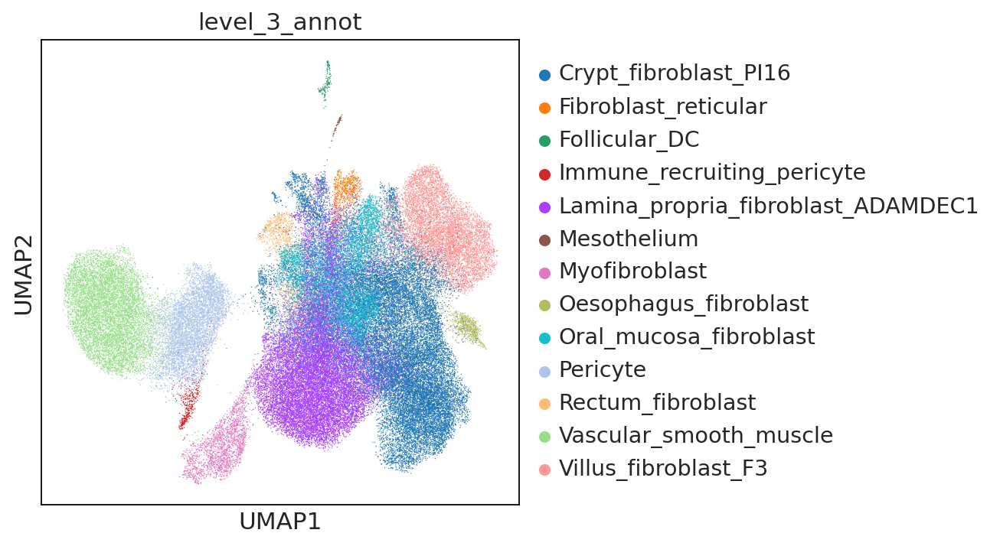

In [98]:
sc.pl.umap(merge,color='level_3_annot')

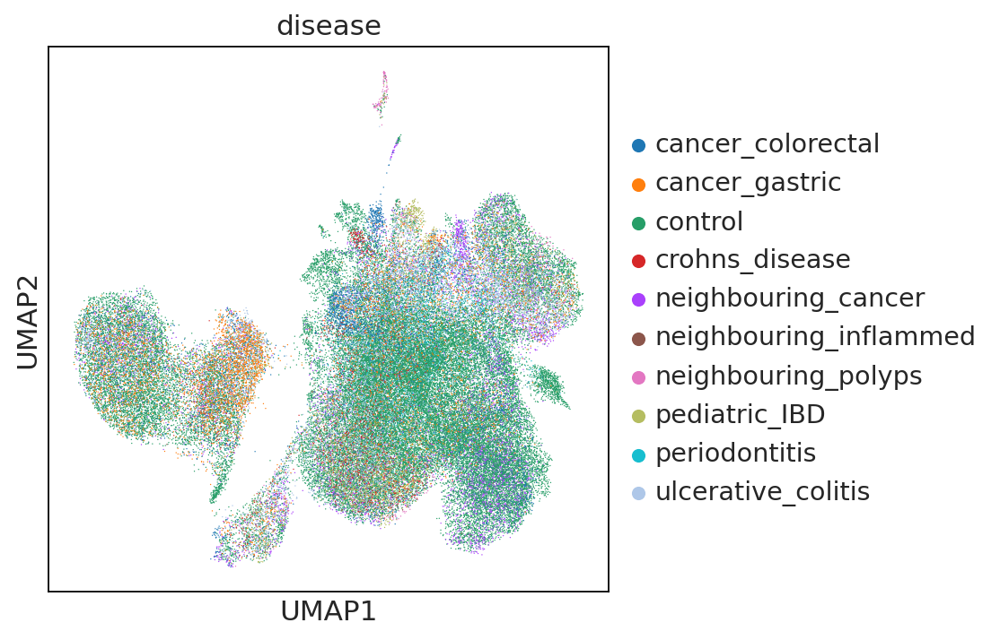

In [99]:
sc.pl.umap(merge,color='disease')

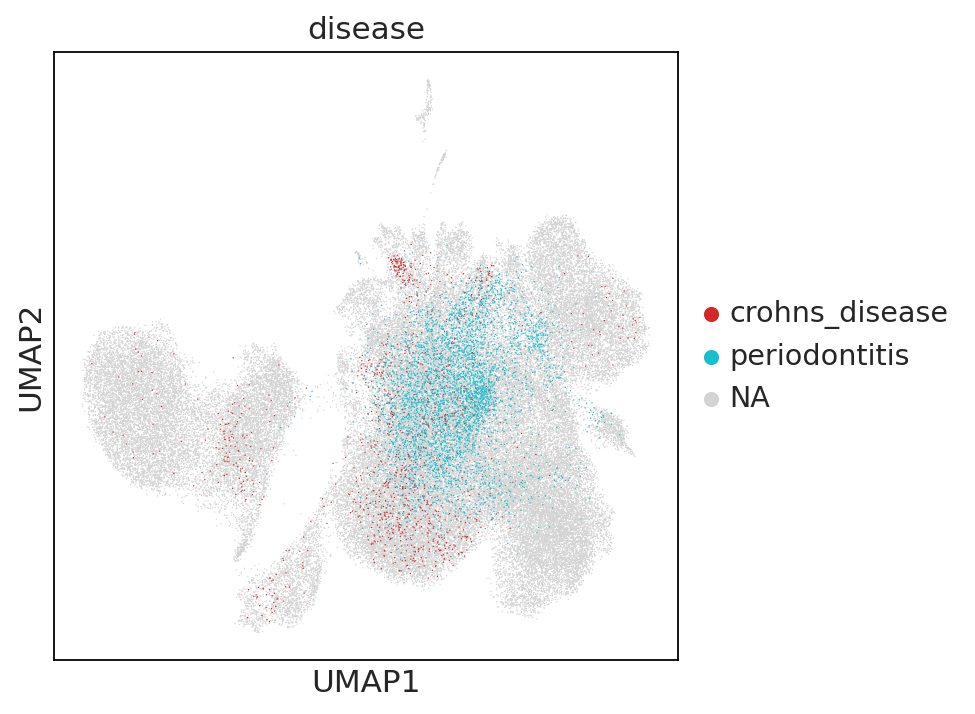

In [100]:
sc.pl.umap(merge,color='disease',groups=['crohns_disease','periodontitis'])

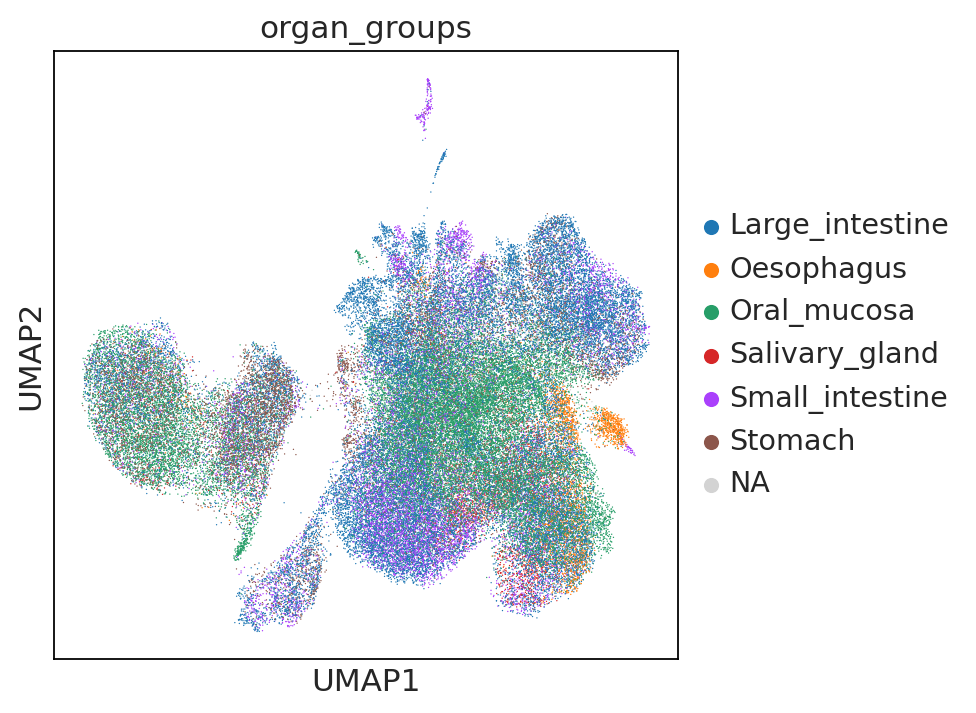

In [101]:
sc.pl.umap(merge,color='organ_groups')

In [102]:
merge.obs['organ_groups'] = merge.obs['organ_groups'].fillna('Oral_mucosa')

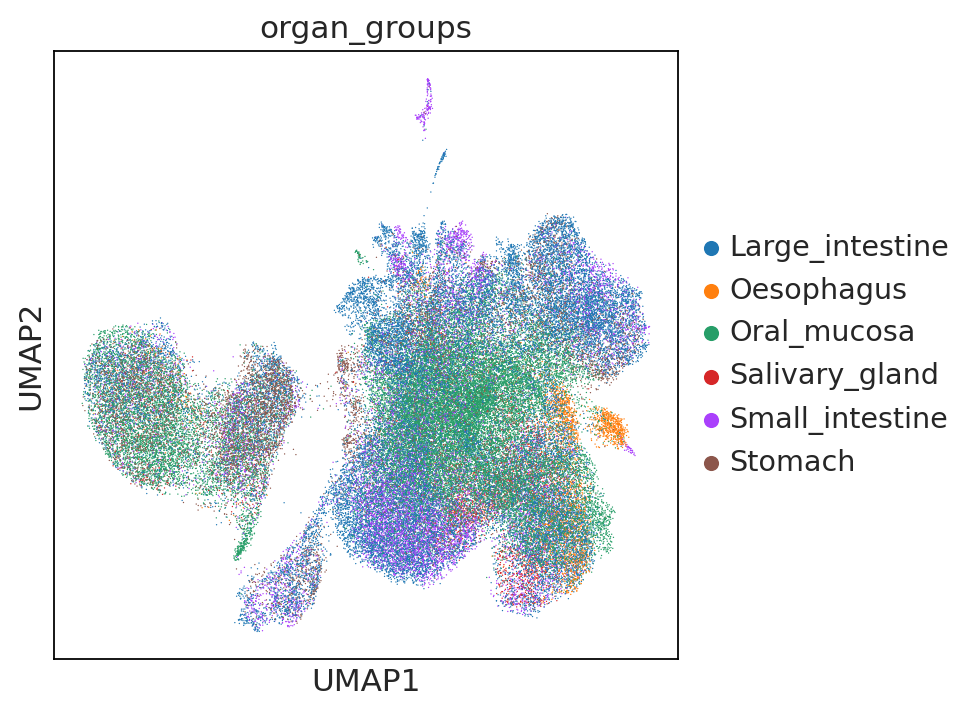

In [103]:
sc.pl.umap(merge,color='organ_groups')

In [104]:
merge.obs['organ_groups'].cat.reorder_categories(['Oral_mucosa','Salivary_gland','Oesophagus',
                                                  'Stomach','Small_intestine','Large_intestine'], inplace=True)


In [105]:
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42

In [106]:
sc.set_figure_params(
    dpi=300,dpi_save=600,
    fontsize=12,
    frameon=False,
    transparent=True,
)

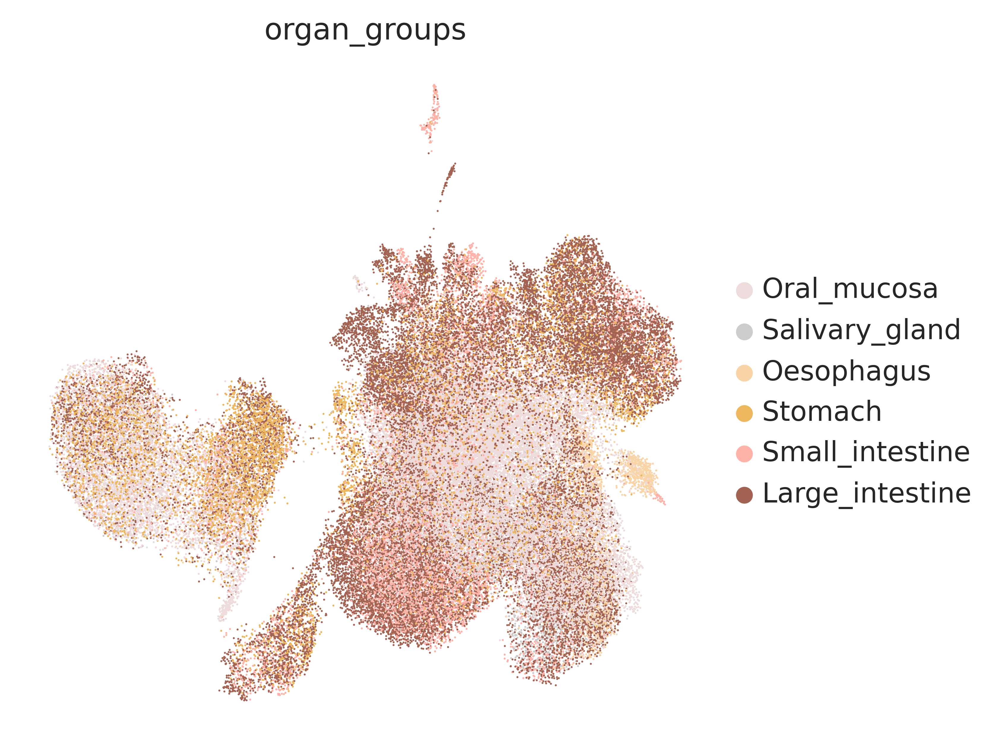

In [107]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(merge,color='organ_groups',palette={'Oral_mucosa': '#eedbdb',
  'Salivary_gland': '#cecbcb',
  'Oesophagus': '#f9d4a7',
                                                   'Stomach': '#edb75f',
  'Small_intestine': '#feb2a8',
  'Large_intestine': '#a36352'}
,size=2.5,save='fibropooled_withWilliams_organ_groups.pdf')


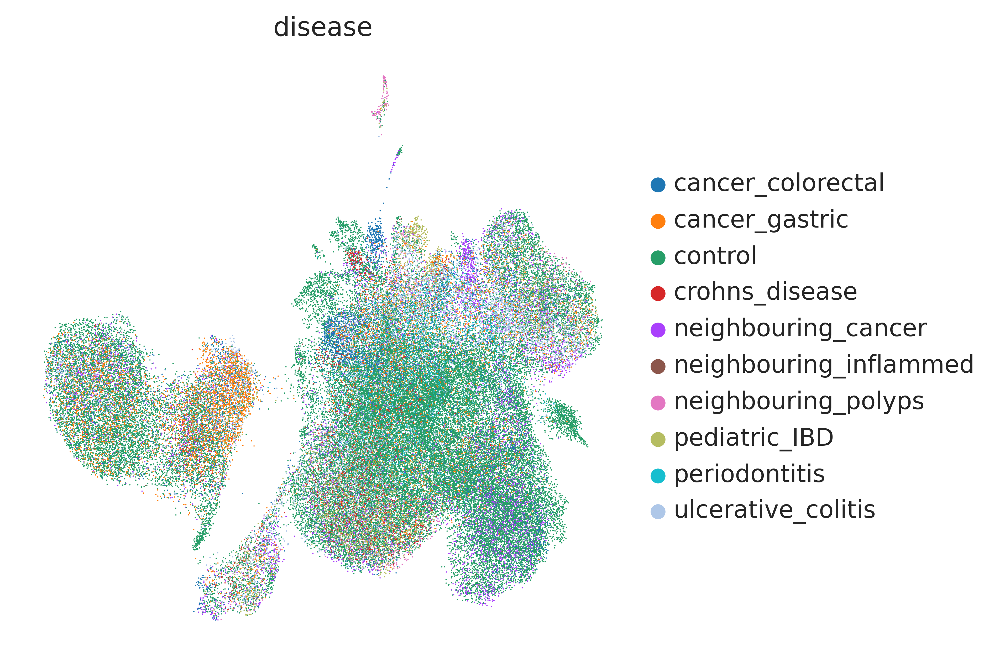

In [108]:
sc.pl.umap(merge,color='disease')

In [109]:
merge.obs['disease'].cat.reorder_categories(['control',
                                             'periodontitis',

 'crohns_disease',
 'ulcerative_colitis',
 'pediatric_IBD',                               
  'neighbouring_inflammed',
   'neighbouring_polyps',
'cancer_colorectal',
 'cancer_gastric',
'neighbouring_cancer'
   ], inplace=True)


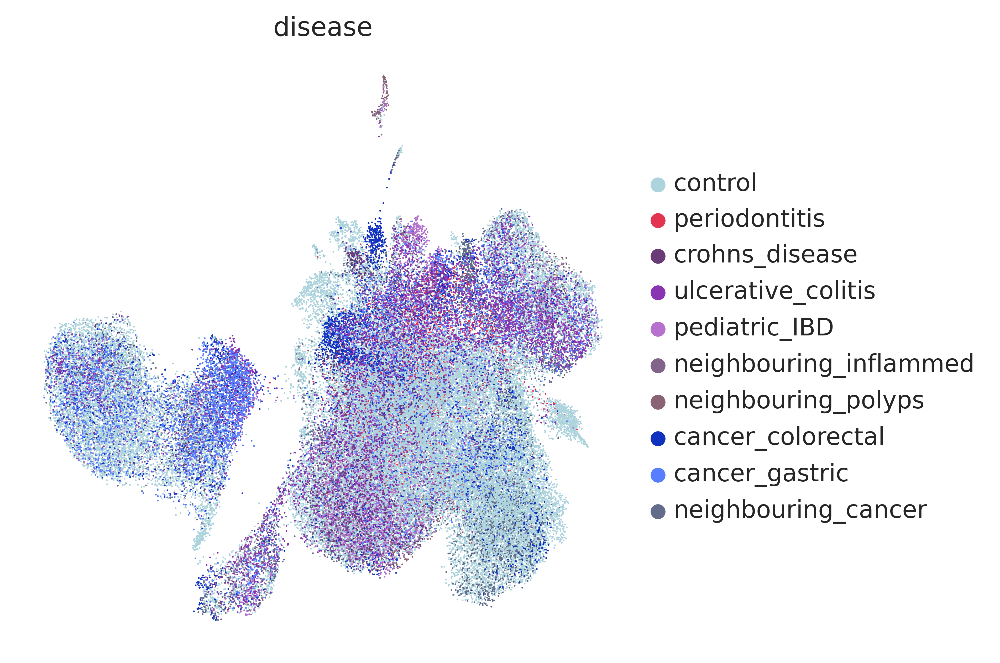

In [110]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(merge,color='disease',palette = {'control': '#ADD3DD',
                                            'periodontitis':'#e33452',
  'inutero': '#ffb7b7',
  'cancer_gastric': '#577eff',
  'crohns_disease': '#693C78',
  'pediatric_IBD': '#B670CD',
  'ulcerative_colitis': '#8934B1',
  'cancer_colorectal': '#1131bf',
  'preterm': '#f48154',
  'celiac_active': '#38B257',
  'celiac_treated': '#b8ed9d',
    'neighbouring_cancer': '#636c8a',
  'neighbouring_polyps': '#8a6375',
  'neighbouring_inflammed': '#82638a' 
                                           },size=2.5,save='fibropooled_withWilliams_disease.pdf')

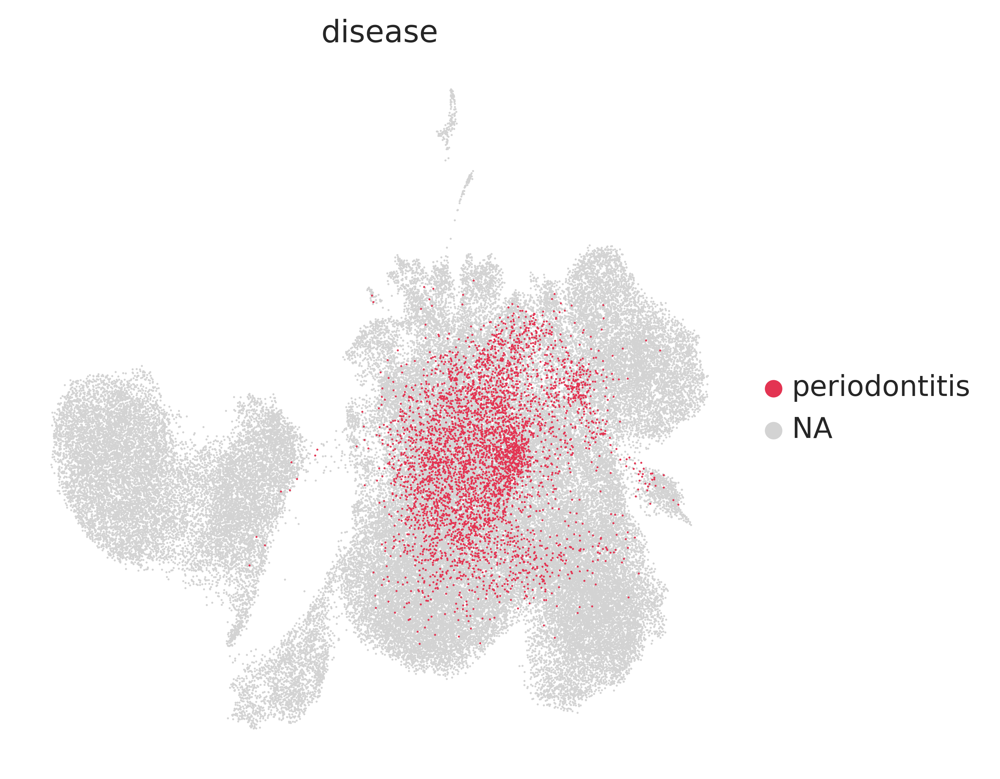

In [111]:
#Extended data 4k
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(merge,color='disease',palette = {'control': '#ADD3DD',
                                            'periodontitis':'#e33452',
  'inutero': '#ffb7b7',
  'cancer_gastric': '#577eff',
  'crohns_disease': '#693C78',
  'pediatric_IBD': '#B670CD',
  'ulcerative_colitis': '#8934B1',
  'cancer_colorectal': '#1131bf',
  'preterm': '#f48154',
  'celiac_active': '#38B257',
  'celiac_treated': '#b8ed9d',
    'neighbouring_cancer': '#636c8a',
  'neighbouring_polyps': '#8a6375',
  'neighbouring_inflammed': '#82638a' 
                                           },size=2.5,groups='periodontitis',save='fibropooled_withWilliams_disease.pdf')

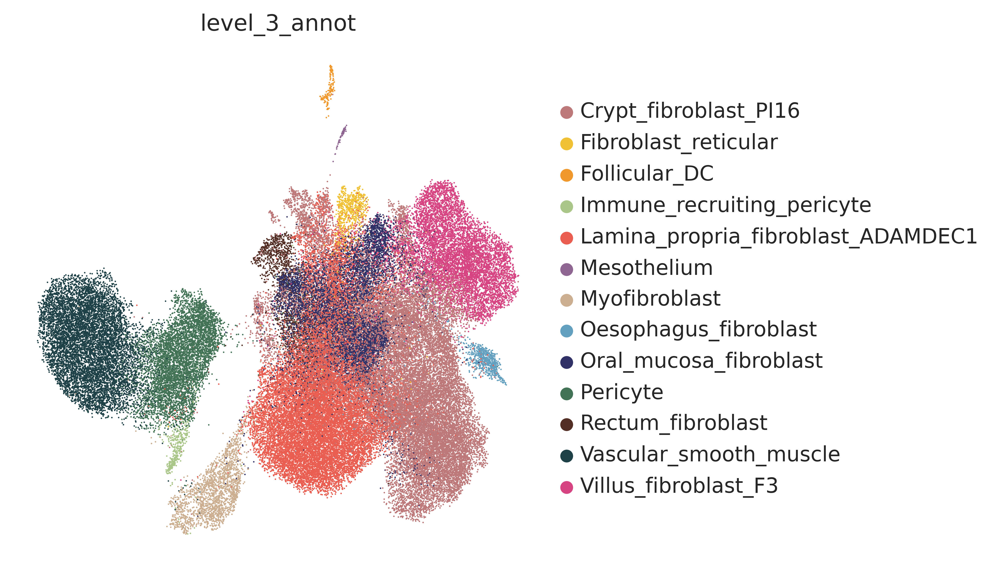

In [112]:
#Extended data 4k
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(merge,color='level_3_annot',palette={
    
  'Crypt_fibroblast_PI16': '#bd7879',
     'Fibroblast_reticular': '#f0c134',

  
    'Follicular_DC': '#f0982c',
     'Immune_recruiting_pericyte': '#AAC789',
    'Lamina_propria_fibroblast_ADAMDEC1': '#e95e50',
     'Mesothelium': '#8F6592',
    'Myofibroblast': '#CCAE91',
    'Oesophagus_fibroblast': '#63A0C0',
  'Oral_mucosa_fibroblast': '#303267',
  
  'Pericyte': '#437356',
    
 
    
      'Rectum_fibroblast': '#522e25',
    'Vascular_smooth_muscle': '#1E4147',
      'Villus_fibroblast_F3': '#d64582',
     
},size=2.5,save='fibropooled_withWilliams_level3annot.pdf')

In [113]:
oral = merge[merge.obs.level_3_annot.isin(['Oral_mucosa_fibroblast'])].copy()

In [114]:
oral

AnnData object with n_obs × n_vars = 8620 × 21932
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'project', 'percent.mt', 'S.Score', 'G2M.Score', 'paperLabels', 'donorID_unified', '_scvi_batch', 'fine_annot', '_scvi_labels', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'log1p_n_counts', 'percent_mito', 'fine_predicted_labels', 'fine_predicted_labels_uncertainty', 'scanvi_pred', 'donor_disease', 'disease', 'fine_predicted_labels_uncertflagged', 'leiden1', 'leiden0.5', 'fine_predicted_labels_resolved', 'level_3_annot', 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'n_genes', 'log1p_n_genes', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_h

In [115]:
merge.X.max()

7635.0

In [116]:
merge.obs.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/metadata/disease/pan-GI_atlas_plus_WilliamsPeriodontitis_mesenchyme.20231206_rawcounts.csv')

In [117]:
del merge.obs

In [118]:
merge.write_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/disease/pan-GI_atlas_plus_WilliamsPeriodontitis_mesenchyme.20231206_rawcounts.h5ad')

In [119]:
merge.layers['counts'] = merge.X

In [120]:
merge

AnnData object with n_obs × n_vars = 81563 × 21932
    var: 'name-0', 'gene_ids-1', 'feature_type-1', 'mito-1', 'ribo-1', 'hb-1', 'cc-1', 'ig-1', 'tcr-1', 'n_counts-0-1', 'n_counts_raw-0-1', 'n_counts_spliced-0-1', 'n_counts_unspliced-0-1', 'n_cells-0-1', 'n_cells_raw-0-1', 'n_cells_spliced-0-1', 'n_cells_unspliced-0-1', 'n_counts-1-1', 'n_counts_raw-1-1', 'n_counts_spliced-1-1', 'n_counts_unspliced-1-1', 'n_cells-1-1', 'n_cells_raw-1-1', 'n_cells_spliced-1-1', 'n_cells_unspliced-1-1'
    uns: 'neighbors', 'umap', 'level_3_annot_colors', 'disease_colors', 'organ_groups_colors'
    obsm: 'X_scANVI', 'X_umap'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [121]:
merge.X.max()

7635.0

In [122]:
merge.layers['counts'].max()

7635.0

In [123]:
sc.pp.normalize_total(merge, target_sum=1e4)
sc.pp.log1p(merge)

In [124]:
merge.X.max()

8.767675

In [125]:
sc.pp.normalize_total(oral, target_sum=1e4)
sc.pp.log1p(oral)

In [126]:
oral.obs.disease.value_counts()

control                   4146
periodontitis             1839
cancer_colorectal          866
ulcerative_colitis         673
pediatric_IBD              377
cancer_gastric             305
neighbouring_cancer        200
crohns_disease             182
neighbouring_polyps         25
neighbouring_inflammed       7
Name: disease, dtype: int64

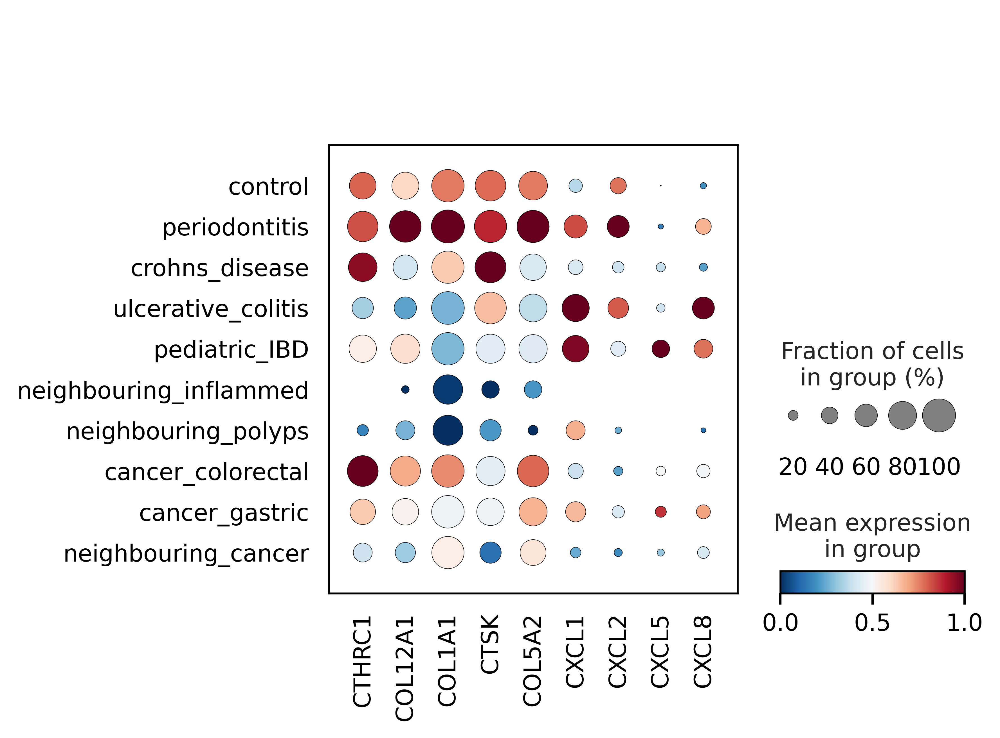

In [127]:
sc.pl.dotplot(oral,var_names=['CTHRC1','COL12A1','COL1A1','CTSK','COL5A2','CXCL1','CXCL2','CXCL5','CXCL8'],groupby='disease',color_map='RdBu_r', standard_scale='var')

In [128]:
oral.obs['disease_simple'] = (
    oral.obs["disease"]
    .map(lambda x: {
        'control':'control',
 'neighbouring_cancer':'neighbouring',
 'neighbouring_polyps':'neighbouring',
 'neighbouring_inflammed':'neighbouring',
 'pediatric_IBD':'disease',
 'cancer_colorectal':'disease',
 'ulcerative_colitis':'disease',
 'crohns_disease':'disease',
 'cancer_gastric':'disease',
        'periodontitis':'disease'
        
         }.get(x, x))
    .astype("category")
)

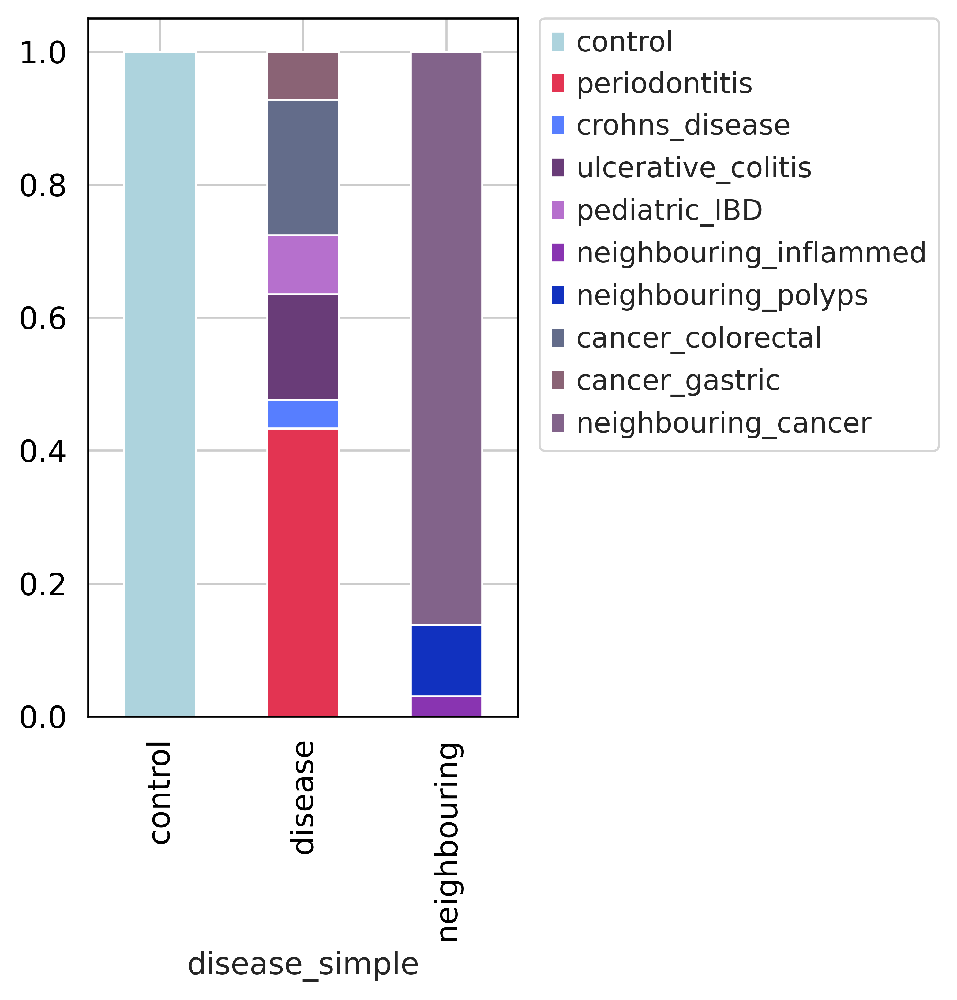

In [129]:
plt.rcParams['figure.figsize'] = [3,5]
tmp = pd.crosstab(oral.obs['disease_simple'], oral.obs['disease'],normalize='index')
tmp.plot.bar(stacked=True, color = [#'control': 
                                    '#ADD3DD',
    #'periodontitis':
    '#e33452',
  #'cancer_gastric': 
    '#577eff',
  #'crohns_disease': 
    '#693C78',
  #'pediatric_IBD': 
    '#B670CD',
  #'ulcerative_colitis': 
    '#8934B1',
  #'cancer_colorectal': 
    '#1131bf',
  

    #'neighbouring_cancer': 
    '#636c8a',
  #'neighbouring_polyps': 
    '#8a6375',
  #'neighbouring_inflammed': 
    '#82638a' ]).legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
plt.savefig('/home/jovyan/ao15/Megagut/Annotations_v3/disease_analysis/oral_mucosa_fibroblasts/figures/pooled_healthy_disease_oralmucosa_stackedbar_control_disease_simplevsdisease.pdf')

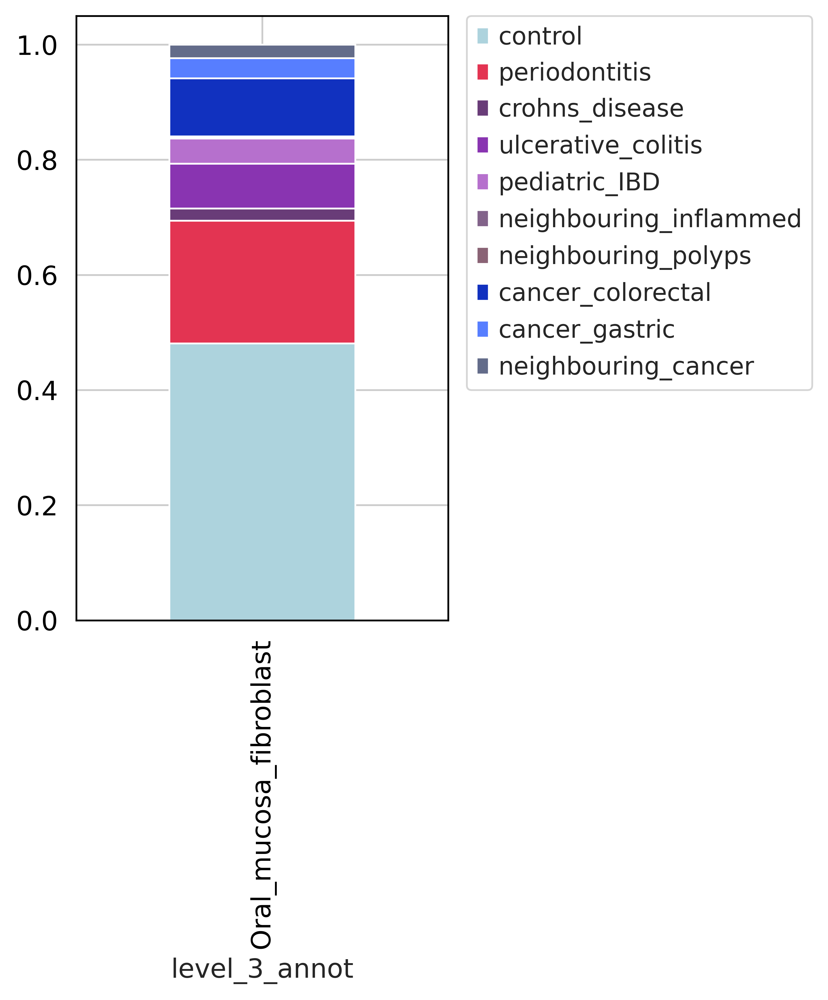

In [130]:
plt.rcParams['figure.figsize'] = [3,5]
tmp = pd.crosstab(oral.obs['level_3_annot'], oral.obs['disease'],normalize='index')
tmp.plot.bar(stacked=True, color = [#'control': 
                                    '#ADD3DD',
    #'periodontitis':
    '#e33452',
  
  #'crohns_disease': 
    '#693C78',
      #'ulcerative_colitis': 
    '#8934B1',
  #'pediatric_IBD': 
    '#B670CD',

 
  
#'neighbouring_inflammed': 
    '#82638a',
   
  #'neighbouring_polyps': 
    '#8a6375',
     #'cancer_colorectal': 
    '#1131bf',
    #'cancer_gastric': 
    '#577eff',
  
 #'neighbouring_cancer': 
    '#636c8a',]).legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
plt.savefig('/home/jovyan/ao15/Megagut/Annotations_v3/disease_analysis/oral_mucosa_fibroblasts/figures/pooled_healthy_disease_oralmucosa_stackedbar_diseases.pdf')

In [131]:
IAF_markers_scoring = ['IL11', 'IL24', 'OSM',
'OSMR', 'WNT2B',
'WNT5B','CXCL1', 'CXCL2',
'CXCL5', 'CXCL8',
'CCL2', 'CCL7', 'TNFSF14', 'CLU',
'IL33', 'IL6', 'LOX',
'GREM1', 'IL1B', 'CXCL5',
'WNT5A', 'IL6', 'IL24']

In [132]:
sc.tl.score_genes(oral,IAF_markers_scoring,score_name ='IAF_marker_score')

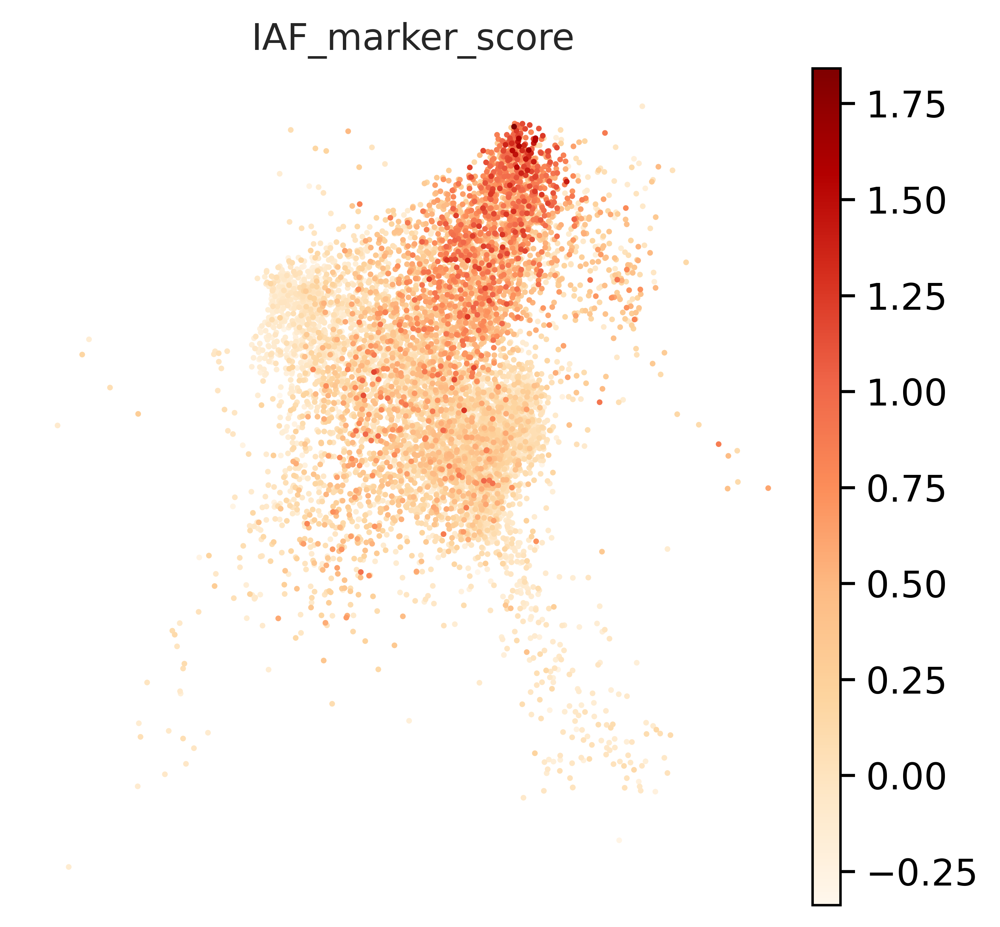

In [133]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(oral,color='IAF_marker_score',cmap='OrRd')

In [134]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.violin(oral,keys = ['IAF_marker_score'],groupby='disease',rotation=90, show=False,save='ORM_Williams_IAFmarkerscore_violin.pdf')

<Axes: ylabel='IAF_marker_score'>

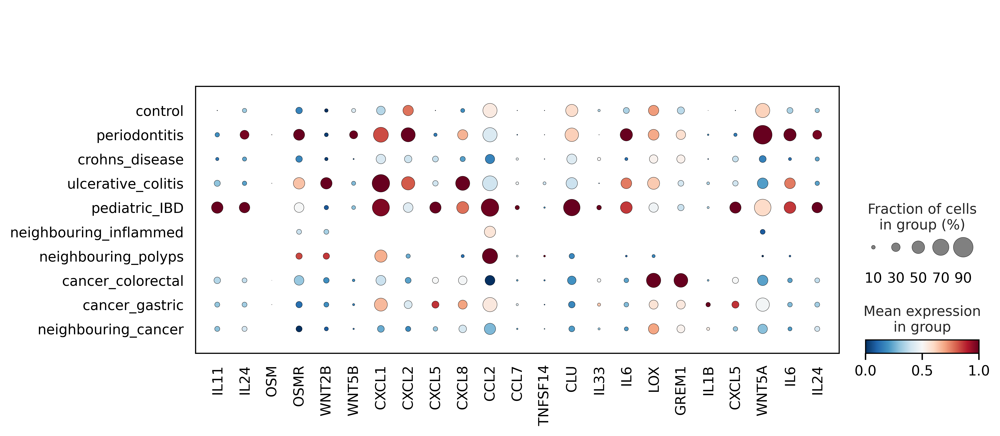

In [135]:
sc.pl.dotplot(oral,var_names=IAF_markers_scoring,groupby='disease',color_map='RdBu_r', standard_scale='var')

In [136]:
KEGG_IL17 = ['CXCL6','CSF3','CSF2','CXCL8','CCL11','TRADD','SRSF1','TNFAIP3','CXCL1','CXCL3','PTGS2','CXCL5','HSP90B1','IKBKB',
             'MAPK8','TBK1','CCL7','CASP3','IKBKG','FADD','MAPK6','IKBKE','MAP3K7','HSP90AA1','MMP1','CCL20','MMP3','TRAF2',
             'MMP9','FOSL1','MAPK10','NFKBIA','CXCL10','IL6','TRAF4','IL1B']

In [137]:
MSIGDB_IFN = ['OGFR','LGALS3BP','TNFAIP3','UBE2L6','ADAR','IFI30','ICAM1','PNP','CASP3','NAMPT','CASP4','EPSTI1','PIM1',
              'CASP1','PDE4B','UPP1','IFNAR2','BATF2','IL4R','RIPK2','TAP1','ARID5B','VAMP8','PLSCR1','PSMA3','ARL4A',
              'IFI27','MTHFD2','PSMA2','IRF7','PSME2','IRF8','LCP2','LAP3','RBCK1','IDO1','MVP','PTGS2','HIF1A','PSMB10',
              'APOL6','PSMB2','CCL7','ISOC1','GBP4','CD74','GCH1','AUTS2','STAT1','LYSMD2','ISG15','NMI','SOD2','PSMB8',
              'PML','PSMB9','BST2','ISG20','NFKBIA','CXCL10','IL6','PTPN2','PFKP']

In [138]:
MSIGDB_inflammatory = ['CXCL6','CSF3','CXCL8','CD82','ATP2A2','ADM','PVR','ICAM1','BEST1','RGS1','NAMPT','PDE4B','BDKRB1',
                       'TIMP1','PTGIR','IL4R','RIPK2','SPHK1','RHOG','PLAUR','OSMR','F3','EREG','MMP14','SELENOS','IL1B',
                       'IRF7','LCP2','ITGA5','RAF1','CHST2','PTGER2','HIF1A','HRH1','CCL7','PDPN','LDLR','CD55','ABCA1',
                       'GCH1','TNFSF15','CCL20','SLC31A1','PCDH7','ADRM1','NMI','INHBA','ATP2B1','DCBLD2','BST2','NFKBIA',
                       'CXCL10','PTPRE','IL6','KLF6','IL7R']

In [139]:
sc.tl.score_genes(oral,KEGG_IL17,score_name = 'KEGG_IL17_score')

In [140]:
sc.tl.score_genes(oral,MSIGDB_IFN,score_name = 'MSIGDB_IFN_score')

In [141]:
sc.tl.score_genes(oral,MSIGDB_inflammatory,score_name = 'MSIGDB_inflammatory_score')

<Axes: ylabel='KEGG_IL17_score'>

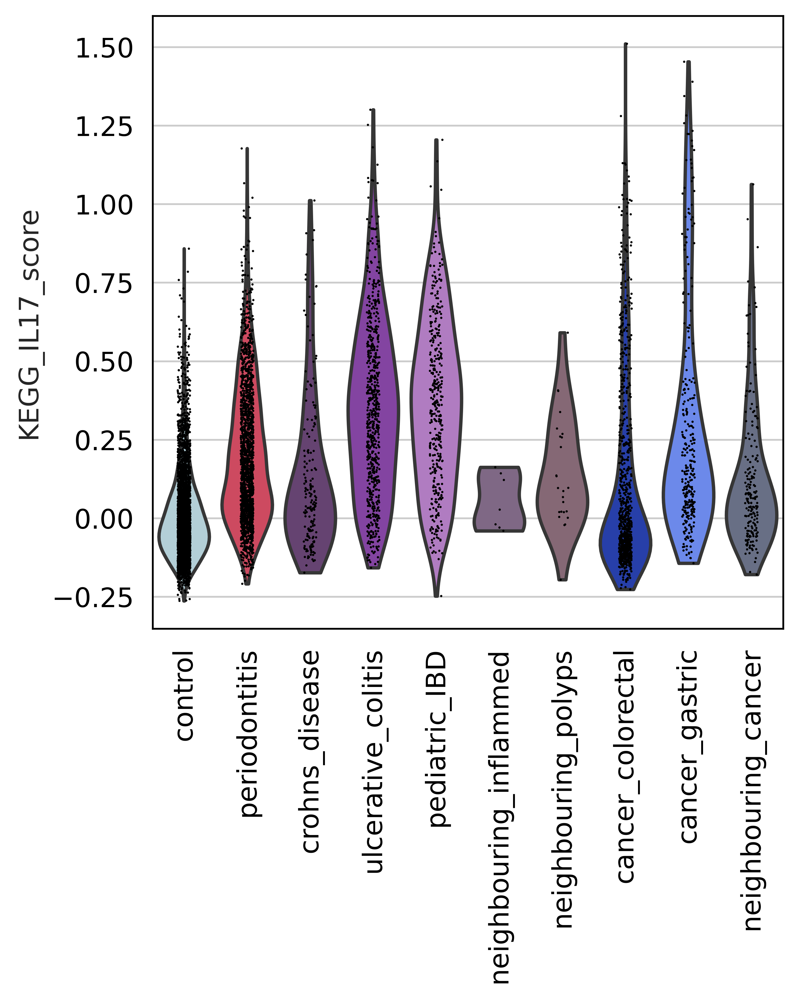

In [142]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.violin(oral,keys = ['KEGG_IL17_score'],groupby='disease',rotation=90, show=False)

<Axes: ylabel='MSIGDB_IFN_score'>

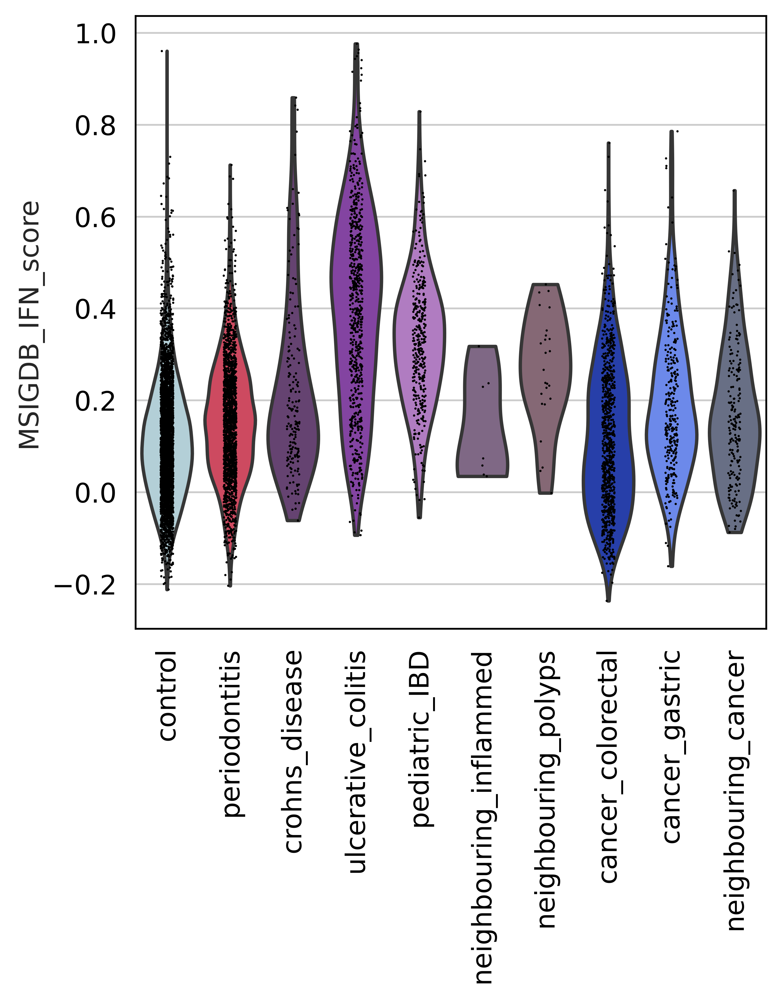

In [143]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.violin(oral,keys = ['MSIGDB_IFN_score'],groupby='disease',rotation=90, show=False)

In [144]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.violin(oral,keys = ['MSIGDB_inflammatory_score'],groupby='disease',rotation=90, show=False,save='ORM_Williams_MSIGDBinflammatoryscore_violin.pdf')

<Axes: ylabel='MSIGDB_inflammatory_score'>

In [145]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.violin(oral,keys = ['MSIGDB_inflammatory_score'],groupby='disease',rotation=90, show=False,save='ORM_Williams_MSIGDBinflammatoryscore_violin.png')

<Axes: ylabel='MSIGDB_inflammatory_score'>

In [146]:
oral.obs['disease_plot'] = (
    oral.obs["disease"]
    .map(lambda x: {
        'control':'control',
 'neighbouring_cancer':'neighbouring_disease',
 'neighbouring_polyps':'neighbouring_disease',
 'neighbouring_inflammed':'neighbouring_disease',
 'pediatric_IBD':'IBD',
 'cancer_colorectal':'cancer',
 'ulcerative_colitis':'IBD',
 'crohns_disease':'IBD',
 'cancer_gastric':'cancer',
        'periodontitis':'periodontitis'
        
         }.get(x, x))
    .astype("category")
)

In [147]:
oral.obs['disease_plot'].cat.reorder_categories(['control',
                                             'periodontitis',

 'IBD',
                                                  'cancer',
                                                  'neighbouring_disease'
   ], inplace=True)


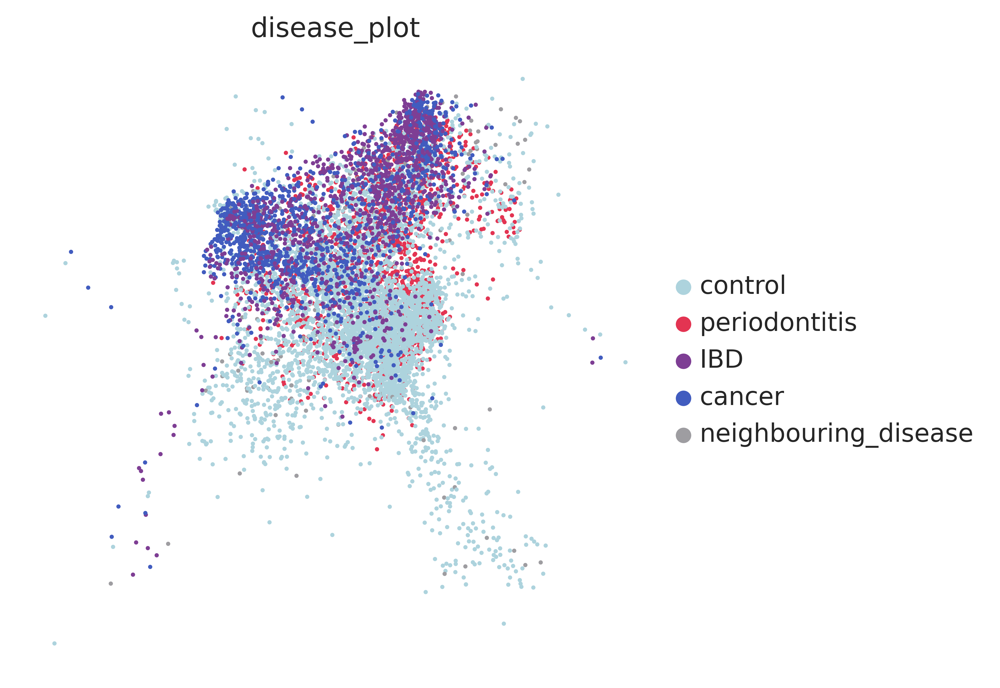

In [148]:
sc.pl.umap(oral,color='disease_plot',palette=[    '#ADD3DD', #'control': 
                                              #'periodontitis':
    '#e33452',
                                              '#7e3e94',#IBD
                                             '#415cbf',#cancer
                                                                 
'#9e9da1',#neighbouring

    ])

In [149]:
#Save figure Extended data 4m
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.violin(oral,keys = ['IAF_marker_score'],groupby='disease_plot',rotation=90, show=False,save='ORM_Williams_IAFmarkerscore_diseaseplot_violin.pdf')

<Axes: ylabel='IAF_marker_score'>

In [150]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.violin(oral,keys = ['MSIGDB_inflammatory_score'],groupby='disease_plot',rotation=90, show=False,save='ORM_Williams_MSIGDBinflammatoryscore_diseaseplot_violin.pdf')

<Axes: ylabel='MSIGDB_inflammatory_score'>

In [151]:
#Save figure Extended data 4m
plt.rcParams['figure.figsize'] = [4,5]
sc.pl.violin(oral,keys = ['IAF_marker_score'],groupby='disease_plot',rotation=90, show=False,save='ORM_Williams_IAFmarkerscore_diseaseplot_violin.png')

<Axes: ylabel='IAF_marker_score'>

In [152]:
plt.rcParams['figure.figsize'] = [4,5]
sc.pl.violin(oral,keys = ['MSIGDB_inflammatory_score'],groupby='disease_plot',rotation=90, show=False,save='ORM_Williams_MSIGDBinflammatoryscore_diseaseplot_violin.png')

<Axes: ylabel='MSIGDB_inflammatory_score'>

In [153]:
adata

AnnData object with n_obs × n_vars = 4777 × 33694
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'project', 'percent.mt', 'S.Score', 'G2M.Score', 'paperLabels', 'donorID_unified', '_scvi_batch', 'fine_annot', '_scvi_labels', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'log1p_n_counts', 'percent_mito', 'fine_predicted_labels', 'fine_predicted_labels_uncertainty', 'scanvi_pred', 'donor_disease', 'disease', 'fine_predicted_labels_uncertflagged', 'leiden1', 'leiden0.5', 'fine_predicted_labels_resolved'
    var: 'name'
    uns: 'paperLabels_colors', 'neighbors', 'umap', 'fine_predicted_labels_colors', 'donor_disease_colors', 'donorID_unified_colors', 'fine_predicted_labels_uncertflagged_colors', 'leiden', 'leiden1_colors', 'leiden0.5_colors', 'fine_predicted_labels_resolved_colors'
    obsm: 'X_pca', 'X_umap', 'X_scANVI'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [154]:
adata.obs['level_3_annot'] = adata.obs.fine_predicted_labels_resolved

In [155]:
adata.obs['Williams2021_annot'] = adata.obs.paperLabels

In [156]:
adata.obs['level_3_annot'].value_counts()

Oral_mucosa_fibroblast                1839
Lamina_propria_fibroblast_ADAMDEC1    1314
Crypt_fibroblast_PI16                 1107
Doublets                               264
Villus_fibroblast_F3                   100
Rectum_fibroblast                       74
Oesophagus_fibroblast                   70
Pericyte                                 5
Fibroblast_reticular                     3
Follicular_DC                            1
Name: level_3_annot, dtype: int64

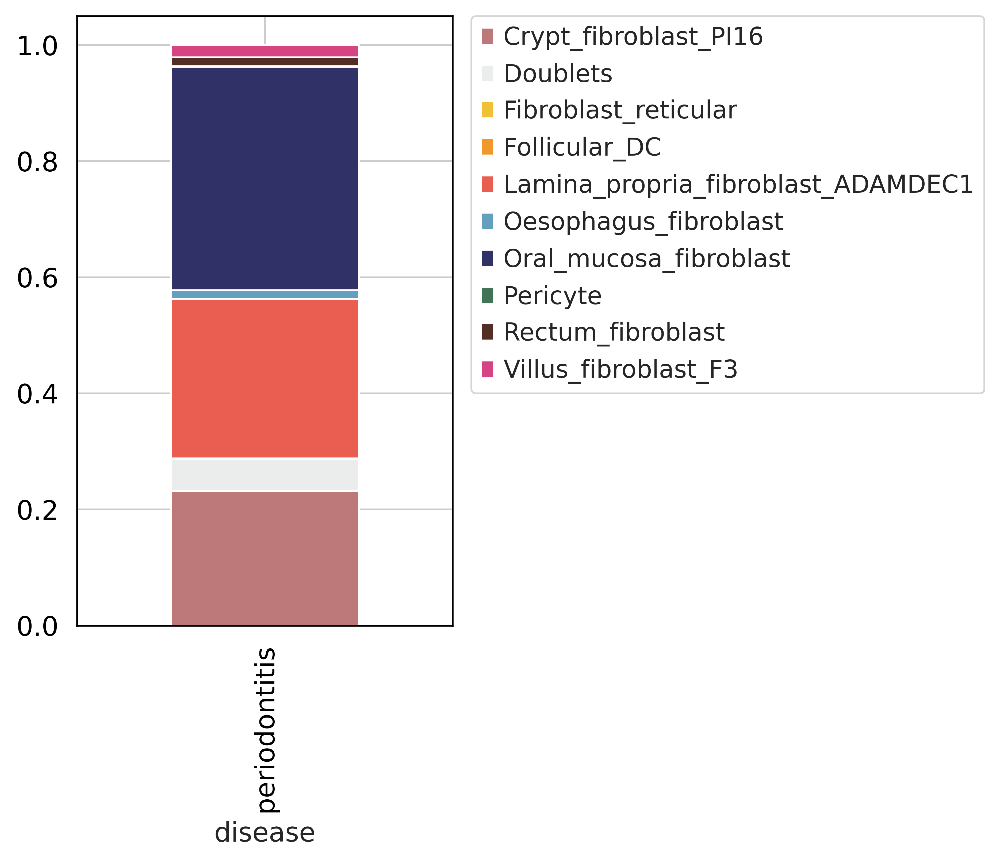

In [157]:
plt.rcParams['figure.figsize'] = [3,5]
tmp = pd.crosstab(adata.obs['disease'],adata.obs['level_3_annot'],normalize='index')
tmp.plot.bar(stacked=True, color = [   
 '#bd7879',# 'Crypt_fibroblast_PI16':
     '#ebeded',#doublets
      '#f0c134',#'Fibroblast_reticular':

  
     '#f0982c',#'Follicular_DC':
     #'Immune_recruiting_pericyte': '#AAC789',
    '#e95e50',#'Lamina_propria_fibroblast_ADAMDEC1': 
    # 'Mesothelium': '#8F6592',
    #'Myofibroblast': '#CCAE91',
     '#63A0C0',#'Oesophagus_fibroblast':
   '#303267',#'Oral_mucosa_fibroblast':
  
  '#437356',#'Pericyte': 
    
 
    
       '#522e25',#'Rectum_fibroblast':
    #'Vascular_smooth_muscle': '#1E4147',
      '#d64582',# 'Villus_fibroblast_F3':
]).legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
plt.savefig('/home/jovyan/ao15/Megagut/Annotations_v3/disease_analysis/oral_mucosa_fibroblasts/figures/Williamsperiodontitis_stackedbar_annotbreakdown.pdf')

In [159]:
merge

AnnData object with n_obs × n_vars = 81563 × 21932
    var: 'name-0', 'gene_ids-1', 'feature_type-1', 'mito-1', 'ribo-1', 'hb-1', 'cc-1', 'ig-1', 'tcr-1', 'n_counts-0-1', 'n_counts_raw-0-1', 'n_counts_spliced-0-1', 'n_counts_unspliced-0-1', 'n_cells-0-1', 'n_cells_raw-0-1', 'n_cells_spliced-0-1', 'n_cells_unspliced-0-1', 'n_counts-1-1', 'n_counts_raw-1-1', 'n_counts_spliced-1-1', 'n_counts_unspliced-1-1', 'n_cells-1-1', 'n_cells_raw-1-1', 'n_cells_spliced-1-1', 'n_cells_unspliced-1-1'
    uns: 'neighbors', 'umap', 'level_3_annot_colors', 'disease_colors', 'organ_groups_colors', 'log1p'
    obsm: 'X_scANVI', 'X_umap'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [160]:
merge.obs = pd.read_csv('/nfs/team205/ao15/Megagut/Annotations_v3/metadata/disease/pan-GI_atlas_plus_WilliamsPeriodontitis_mesenchyme.20231206_rawcounts.csv',index_col=0)

In [161]:
healthy_oral = merge[merge.obs.organ_groups.isin(['Oral_mucosa'])].copy()

In [162]:
healthy_oral = healthy_oral[healthy_oral.obs.disease.isin(['control'])].copy()

In [163]:
healthy_oral.obs.study.value_counts()

Williams2021    23115
Caetano2021       781
Pagella2021       753
Name: study, dtype: int64

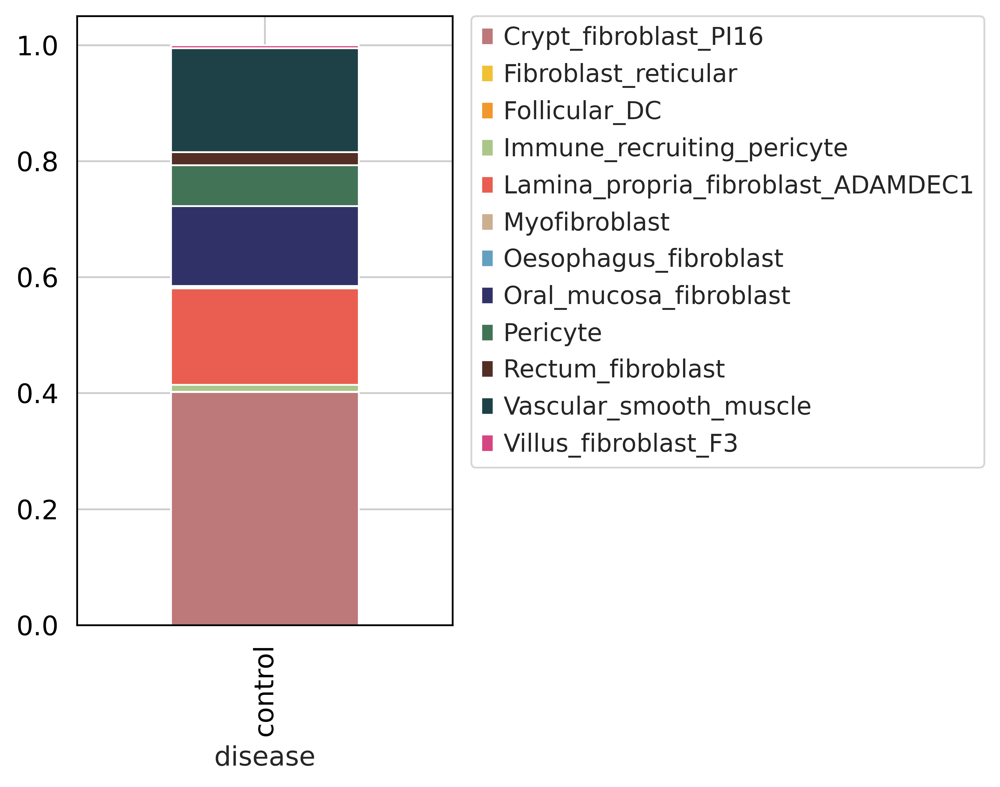

In [164]:
plt.rcParams['figure.figsize'] = [3,5]
tmp = pd.crosstab(healthy_oral.obs['disease'],healthy_oral.obs['level_3_annot'],normalize='index')
tmp.plot.bar(stacked=True, color = [   
 '#bd7879',# 'Crypt_fibroblast_PI16':
     
      '#f0c134',#'Fibroblast_reticular':

  
     '#f0982c',#'Follicular_DC':
      '#AAC789',#'Immune_recruiting_pericyte':
    '#e95e50',#'Lamina_propria_fibroblast_ADAMDEC1': 
    # 'Mesothelium': '#8F6592',
     '#CCAE91',#'Myofibroblast':
     '#63A0C0',#'Oesophagus_fibroblast':
   '#303267',#'Oral_mucosa_fibroblast':
  
  '#437356',#'Pericyte': 
    
 
    
       '#522e25',#'Rectum_fibroblast':
    '#1E4147',#'Vascular_smooth_muscle': 
      '#d64582',# 'Villus_fibroblast_F3':
]).legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
plt.savefig('/home/jovyan/ao15/Megagut/Annotations_v3/disease_analysis/oral_mucosa_fibroblasts/figures/Oral_mucosa_healthy_stackedbar_annotbreakdown.pdf')

In [165]:
adata.obs.level_3_annot.value_counts()

Oral_mucosa_fibroblast                1839
Lamina_propria_fibroblast_ADAMDEC1    1314
Crypt_fibroblast_PI16                 1107
Doublets                               264
Villus_fibroblast_F3                   100
Rectum_fibroblast                       74
Oesophagus_fibroblast                   70
Pericyte                                 5
Fibroblast_reticular                     3
Follicular_DC                            1
Name: level_3_annot, dtype: int64

In [166]:
sc.pl.dotplot(adata,var_names=marker_genes_dict,groupby='level_3_annot',color_map='RdBu_r', standard_scale='var')

In [167]:
sc.pl.dotplot(healthy_oral,var_names=marker_genes_dict,groupby='level_3_annot',color_map='RdBu_r', standard_scale='var')

In [168]:
adata_subset = adata[~adata.obs.level_3_annot.isin(['Pericyte','Fibroblast_reticular','Follicular_DC'])].copy()

In [169]:
adata

AnnData object with n_obs × n_vars = 4777 × 33694
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'project', 'percent.mt', 'S.Score', 'G2M.Score', 'paperLabels', 'donorID_unified', '_scvi_batch', 'fine_annot', '_scvi_labels', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'log1p_n_counts', 'percent_mito', 'fine_predicted_labels', 'fine_predicted_labels_uncertainty', 'scanvi_pred', 'donor_disease', 'disease', 'fine_predicted_labels_uncertflagged', 'leiden1', 'leiden0.5', 'fine_predicted_labels_resolved', 'level_3_annot', 'Williams2021_annot'
    var: 'name'
    uns: 'paperLabels_colors', 'neighbors', 'umap', 'fine_predicted_labels_colors', 'donor_disease_colors', 'donorID_unified_colors', 'fine_predicted_labels_uncertflagged_colors', 'leiden', 'leiden1_colors', 'leiden0.5_colors', 'fine_predicted_labels_resolved_colors'
    obsm: 'X_pca', 'X_umap', 'X_scANVI'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [170]:
adata_subset

AnnData object with n_obs × n_vars = 4768 × 33694
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'project', 'percent.mt', 'S.Score', 'G2M.Score', 'paperLabels', 'donorID_unified', '_scvi_batch', 'fine_annot', '_scvi_labels', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'log1p_n_counts', 'percent_mito', 'fine_predicted_labels', 'fine_predicted_labels_uncertainty', 'scanvi_pred', 'donor_disease', 'disease', 'fine_predicted_labels_uncertflagged', 'leiden1', 'leiden0.5', 'fine_predicted_labels_resolved', 'level_3_annot', 'Williams2021_annot'
    var: 'name'
    uns: 'paperLabels_colors', 'neighbors', 'umap', 'fine_predicted_labels_colors', 'donor_disease_colors', 'donorID_unified_colors', 'fine_predicted_labels_uncertflagged_colors', 'leiden', 'leiden1_colors', 'leiden0.5_colors', 'fine_predicted_labels_resolved_colors'
    obsm: 'X_pca', 'X_umap', 'X_scANVI'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

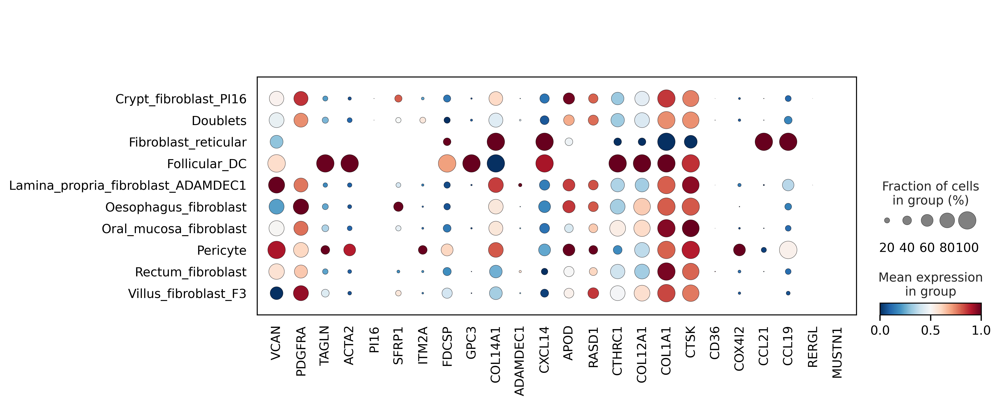

In [171]:
sc.pl.dotplot(adata,var_names=['VCAN','PDGFRA','TAGLN','ACTA2','PI16','SFRP1','ITM2A','FDCSP','GPC3','COL14A1','ADAMDEC1','CXCL14','APOD','RASD1','CTHRC1','COL12A1','COL1A1','CTSK','CD36','COX4I2','CCL21','CCL19','RERGL','MUSTN1'],groupby='level_3_annot',color_map='RdBu_r', standard_scale='var')

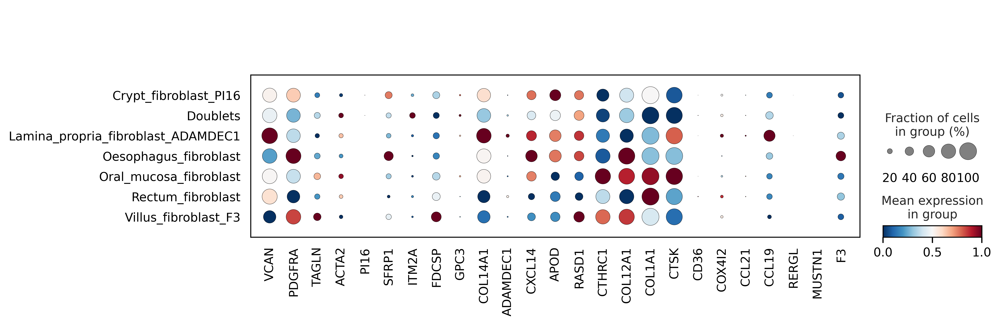

In [172]:
sc.pl.dotplot(adata_subset,var_names=['VCAN','PDGFRA','TAGLN','ACTA2','PI16','SFRP1','ITM2A','FDCSP','GPC3','COL14A1','ADAMDEC1','CXCL14','APOD','RASD1','CTHRC1','COL12A1','COL1A1','CTSK','CD36','COX4I2','CCL21','CCL19','RERGL','MUSTN1','F3'],groupby='level_3_annot',color_map='RdBu_r', standard_scale='var')

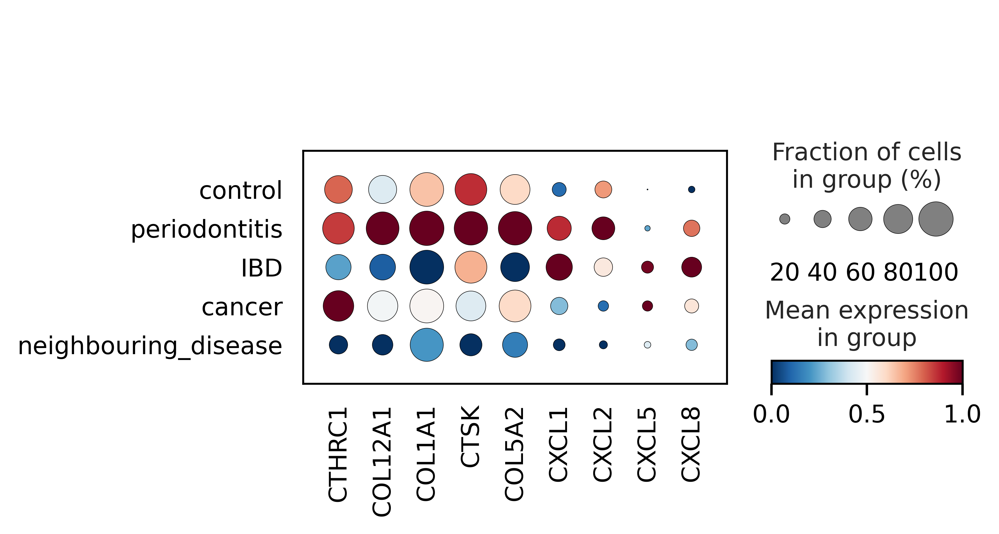

In [173]:
sc.pl.dotplot(oral,var_names=['CTHRC1','COL12A1','COL1A1','CTSK','COL5A2','CXCL1','CXCL2','CXCL5','CXCL8'],groupby='disease_plot',color_map='RdBu_r', standard_scale='var')

In [174]:
merge

AnnData object with n_obs × n_vars = 81563 × 21932
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'project', 'percent.mt', 'S.Score', 'G2M.Score', 'paperLabels', 'donorID_unified', '_scvi_batch', 'fine_annot', '_scvi_labels', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'log1p_n_counts', 'percent_mito', 'fine_predicted_labels', 'fine_predicted_labels_uncertainty', 'scanvi_pred', 'donor_disease', 'disease', 'fine_predicted_labels_uncertflagged', 'leiden1', 'leiden0.5', 'fine_predicted_labels_resolved', 'level_3_annot', 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'n_genes', 'log1p_n_genes', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_

In [175]:
list(merge.obs.level_3_annot.unique())

['Oral_mucosa_fibroblast',
 'Crypt_fibroblast_PI16',
 'Lamina_propria_fibroblast_ADAMDEC1',
 'Villus_fibroblast_F3',
 'Rectum_fibroblast',
 'Oesophagus_fibroblast',
 'Pericyte',
 'Follicular_DC',
 'Fibroblast_reticular',
 'Vascular_smooth_muscle',
 'Immune_recruiting_pericyte',
 'Myofibroblast',
 'Mesothelium']

In [176]:
merge.obs['oral_annot'] =  (
    merge.obs["level_3_annot"]
    .map(lambda x: {'Oral_mucosa_fibroblast':'Oral_mucosa_fibroblast',
 'Crypt_fibroblast_PI16':'Other_fibro',
 'Lamina_propria_fibroblast_ADAMDEC1':'Other_fibro',
 'Villus_fibroblast_F3':'Other_fibro',
 'Rectum_fibroblast':'Other_fibro',
 'Oesophagus_fibroblast':'Other_fibro',
 'Pericyte':'Other_mes',
 'Follicular_DC':'Other_mes',
 'Fibroblast_reticular':'Other_fibro',
 'Vascular_smooth_muscle':'Other_mes',
 'Immune_recruiting_pericyte':'Other_mes',
 'Myofibroblast':'Other_mes',
 'Mesothelium':'Other_mes'
        
         }.get(x, x))
    .astype("category")
)

In [177]:
list(merge.obs.oral_annot.unique())

['Oral_mucosa_fibroblast', 'Other_fibro', 'Other_mes']

In [178]:
merge.obs['disease_plot'] = (
    merge.obs["disease"]
    .map(lambda x: {
        'control':'control',
 'neighbouring_cancer':'neighbouring_disease',
 'neighbouring_polyps':'neighbouring_disease',
 'neighbouring_inflammed':'neighbouring_disease',
 'pediatric_IBD':'IBD',
 'cancer_colorectal':'cancer',
 'ulcerative_colitis':'IBD',
 'crohns_disease':'IBD',
 'cancer_gastric':'cancer',
        'periodontitis':'periodontitis'
        
         }.get(x, x))
    .astype("category")
)

In [179]:
merge.obs['oral_annot_disease_plot'] = merge.obs['oral_annot'].astype(str) + '_' + merge.obs['disease_plot'].astype(str)

In [180]:
merge.obs['oral_annot_disease_plot'].unique()

array(['Oral_mucosa_fibroblast_periodontitis',
       'Other_fibro_periodontitis', 'Other_mes_periodontitis',
       'Other_fibro_control', 'Other_mes_control',
       'Oral_mucosa_fibroblast_control',
       'Other_fibro_neighbouring_disease',
       'Oral_mucosa_fibroblast_neighbouring_disease',
       'Other_mes_neighbouring_disease', 'Other_fibro_IBD',
       'Other_mes_IBD', 'Oral_mucosa_fibroblast_IBD',
       'Oral_mucosa_fibroblast_cancer', 'Other_fibro_cancer',
       'Other_mes_cancer'], dtype=object)

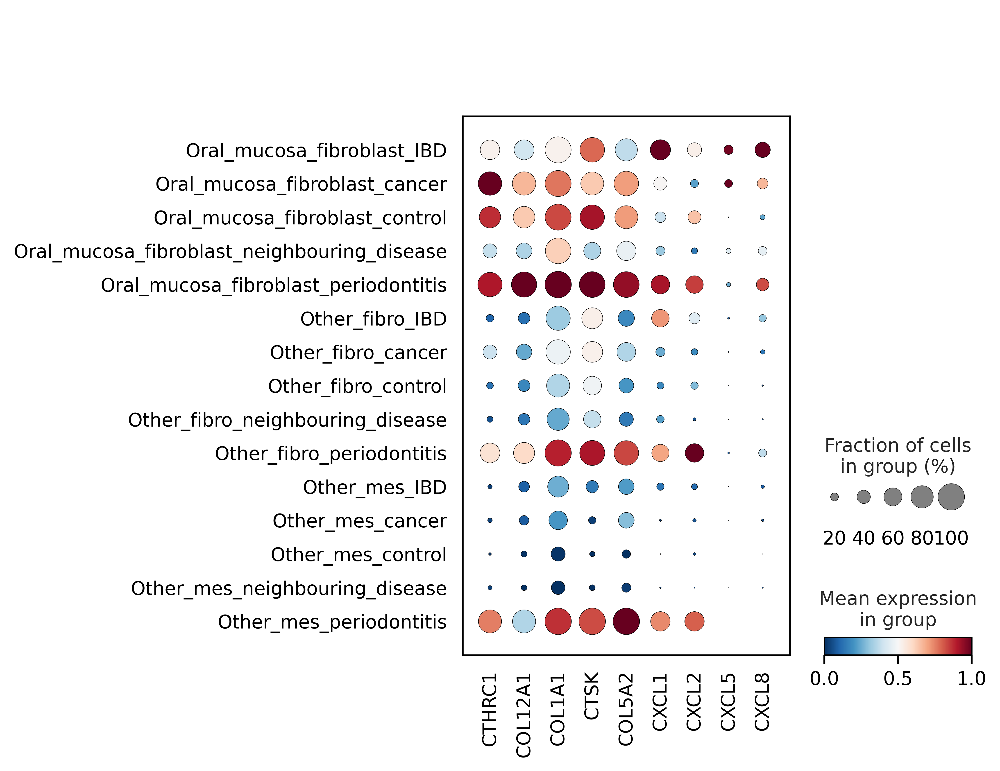

In [181]:
sc.pl.dotplot(merge,var_names=['CTHRC1','COL12A1','COL1A1','CTSK','COL5A2','CXCL1','CXCL2','CXCL5','CXCL8'],groupby='oral_annot_disease_plot',color_map='RdBu_r', standard_scale='var')

In [182]:
plot = merge[merge.obs.oral_annot_disease_plot.isin(['Oral_mucosa_fibroblast_periodontitis','Other_fibro_control','Oral_mucosa_fibroblast_control','Oral_mucosa_fibroblast_IBD','Other_fibro_IBD'])]

In [183]:
plot.obs['oral_annot_disease_plot'].cat.reorder_categories(['Oral_mucosa_fibroblast_control',
                                                            
                                                            'Oral_mucosa_fibroblast_periodontitis',
                                                            'Oral_mucosa_fibroblast_IBD',
                                                            'Other_fibro_control',
                                                            
                                                            'Other_fibro_IBD'
   ], inplace=True)


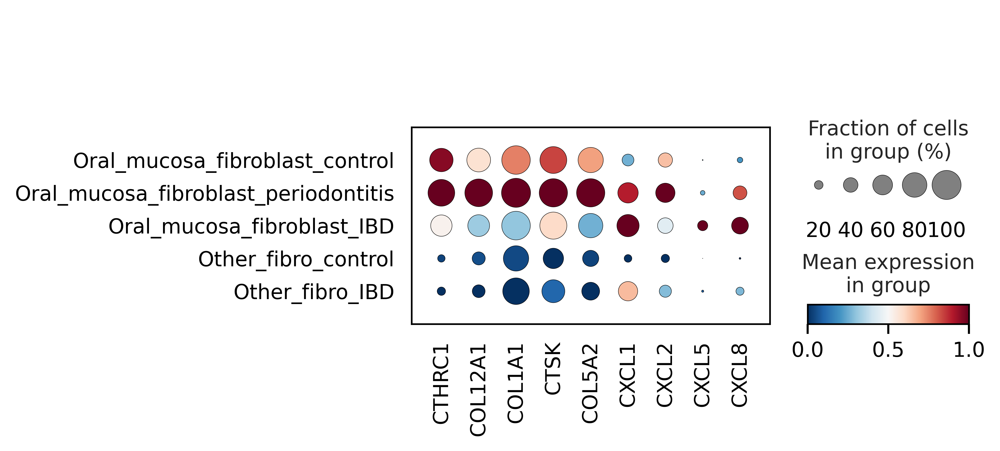

In [184]:
#Save figure - Extended data 4l
sc.pl.dotplot(plot,var_names=['CTHRC1','COL12A1','COL1A1','CTSK','COL5A2','CXCL1','CXCL2','CXCL5','CXCL8'],groupby='oral_annot_disease_plot',color_map='RdBu_r', standard_scale='var',save='periodontitis_data_oral_mucosa_markers.pdf')

In [185]:
merge.obs.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/metadata/disease/pan-GI_atlas_plus_WilliamsPeriodontitis_mesenchyme.20231206.csv')

In [186]:
del merge.obs

In [187]:
merge.write_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/disease/pan-GI_atlas_plus_WilliamsPeriodontitis_mesenchyme.20231206.h5ad')

In [188]:
merge

AnnData object with n_obs × n_vars = 81563 × 21932
    var: 'name-0', 'gene_ids-1', 'feature_type-1', 'mito-1', 'ribo-1', 'hb-1', 'cc-1', 'ig-1', 'tcr-1', 'n_counts-0-1', 'n_counts_raw-0-1', 'n_counts_spliced-0-1', 'n_counts_unspliced-0-1', 'n_cells-0-1', 'n_cells_raw-0-1', 'n_cells_spliced-0-1', 'n_cells_unspliced-0-1', 'n_counts-1-1', 'n_counts_raw-1-1', 'n_counts_spliced-1-1', 'n_counts_unspliced-1-1', 'n_cells-1-1', 'n_cells_raw-1-1', 'n_cells_spliced-1-1', 'n_cells_unspliced-1-1'
    uns: 'neighbors', 'umap', 'level_3_annot_colors', 'disease_colors', 'organ_groups_colors', 'log1p'
    obsm: 'X_scANVI', 'X_umap'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [189]:
merge.layers['counts']

<81563x21932 sparse matrix of type '<class 'numpy.float32'>'
	with 125832005 stored elements in Compressed Sparse Row format>

In [190]:
merge.layers['counts'].max()

8.767675